In [1]:
## load useful libraries
# suppressWarnings(suppressPackageStartupMessages(library(rhdf5)))
# suppressWarnings(suppressPackageStartupMessages(library(qvalue)))
suppressWarnings(suppressPackageStartupMessages(library(dplyr)))
suppressWarnings(suppressPackageStartupMessages(library(cowplot)))
# suppressWarnings(suppressPackageStartupMessages(library(tidyverse)))
# suppressWarnings(suppressPackageStartupMessages(library(ggbeeswarm)))
suppressWarnings(suppressPackageStartupMessages(library(ggthemes)))
# # suppressWarnings(suppressPackageStartupMessages(library(SingleCellExperiment)))
# suppressWarnings(suppressPackageStartupMessages(library(edgeR)))
# suppressWarnings(suppressPackageStartupMessages(library(limma)))
suppressWarnings(suppressPackageStartupMessages(library(ggplot2)))
# suppressWarnings(suppressPackageStartupMessages(library(ISLR)))
# suppressWarnings(suppressPackageStartupMessages(library(GGally)))
suppressWarnings(suppressPackageStartupMessages(library(scran)))
# suppressWarnings(suppressPackageStartupMessages(library(ComplexHeatmap)))
# suppressWarnings(suppressPackageStartupMessages(library(circlize)))
suppressWarnings(suppressPackageStartupMessages(library(RColorBrewer)))

In [22]:
gwas_annos_filename = "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_endodiff/data/qtl_annotation/all_results_combined.GWAS.tagging.1000g_ref.txt"
gwas_annos = read.csv(gwas_annos_filename, sep = "\t", row.names = 1)
head(gwas_annos)

,beta.mean,beta_se,empirical_feature_p_value,p_value.mean,snp_id,feature,global_corr_p_value,snp_chromosome,snp_position,ref_allele,⋯,stage,sign.mean,stage_specific,p_value.int,q_value,beta.int,sign.int,GWAS_Variant,GWAS_Annotation,GWAS_LD
0,-1.386281,0.1083733,1.592971e-18,1.823854e-37,6_31132414_G_A,ENSG00000204531_POU5F1,5.264237e-16,6,31132414,G,⋯,ips,True,False,2.225074e-308,1.184094e-305,0.017999188,True,-,-,-
1,-1.270786,0.1469673,1.977147e-11,5.299864e-18,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.340269e-09,6,32634922,A,⋯,ips,True,False,2.225074e-308,1.184094e-305,-0.014912210,True,{6_32663631};{6_32636120},"{http://www.ebi.ac.uk/efo/EFO_0005140, http://www.ebi.ac.uk/efo/EFO_0003885, http://www.ebi.ac.uk/efo/EFO_0001444, http://purl.obolibrary.org/obo/IAO_0000030, http://www.ebi.ac.uk/efo/EFO_0005206, http://www.ifomis.org/bfo/1.1/snap#SpecificallyDependentContinuant, http://www.ebi.ac.uk/efo/EFO_0000408, http://www.ebi.ac.uk/efo/EFO_0000618, http://www.ifomis.org/bfo/1.1/snap#Disposition, http://www.ebi.ac.uk/efo/EFO_0000540, http://www.ebi.ac.uk/efo/EFO_0000001};{http://www.ebi.ac.uk/efo/EFO_0005570, http://www.ebi.ac.uk/efo/EFO_0000311, http://www.ifomis.org/bfo/1.1/snap#SpecificallyDependentContinuant, http://www.ebi.ac.uk/efo/EFO_0000408, http://www.ifomis.org/bfo/1.1/snap#Disposition, http://www.ebi.ac.uk/efo/EFO_0005577, http://www.ebi.ac.uk/efo/EFO_0000616, http://www.ebi.ac.uk/efo/EFO_1001931, http://www.ebi.ac.uk/efo/EFO_0000001}",{0.843256176178797};{0.8248069087686078}
2,-1.375988,0.1478612,8.485500e-15,1.328104e-20,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.519887e-12,6,32634922,A,⋯,mesendo,True,False,2.225074e-308,1.184094e-305,-0.014912210,True,{6_32663631};{6_32636120},"{http://www.ebi.ac.uk/efo/EFO_0005140, http://www.ebi.ac.uk/efo/EFO_0003885, http://www.ebi.ac.uk/efo/EFO_0001444, http://purl.obolibrary.org/obo/IAO_0000030, http://www.ebi.ac.uk/efo/EFO_0005206, http://www.ifomis.org/bfo/1.1/snap#SpecificallyDependentContinuant, http://www.ebi.ac.uk/efo/EFO_0000408, http://www.ebi.ac.uk/efo/EFO_0000618, http://www.ifomis.org/bfo/1.1/snap#Disposition, http://www.ebi.ac.uk/efo/EFO_0000540, http://www.ebi.ac.uk/efo/EFO_0000001};{http://www.ebi.ac.uk/efo/EFO_0005570, http://www.ebi.ac.uk/efo/EFO_0000311, http://www.ifomis.org/bfo/1.1/snap#SpecificallyDependentContinuant, http://www.ebi.ac.uk/efo/EFO_0000408, http://www.ifomis.org/bfo/1.1/snap#Disposition, http://www.ebi.ac.uk/efo/EFO_0005577, http://www.ebi.ac.uk/efo/EFO_0000616, http://www.ebi.ac.uk/efo/EFO_1001931, http://www.ebi.ac.uk/efo/EFO_0000001}",{0.843256176178797};{0.8248069087686078}
3,-1.438379,0.1499301,3.298243e-12,8.500689e-22,6_32634922_A_G,ENSG00000179344_HLA-DQB1,5.981274e-10,6,32634922,A,⋯,defendo,True,False,2.225074e-308,1.184094e-305,-0.014912210,True,{6_32663631};{6_32636120},"{http://www.ebi.ac.uk/efo/EFO_0005140, http://www.ebi.ac.uk/efo/EFO_0003885, http://www.ebi.ac.uk/efo/EFO_0001444, http://purl.obolibrary.org/obo/IAO_0000030, http://www.ebi.ac.uk/efo/EFO_0005206, http://www.ifomis.org/bfo/1.1/snap#SpecificallyDependentContinuant, http://www.ebi.ac.uk/efo/EFO_0000408, http://www.ebi.ac.uk/efo/EFO_0000618, http://www.ifomis.org/bfo/1.1/snap#Disposition, http://www.ebi.ac.uk/efo/EFO_0000540, http://www.ebi.ac.uk/efo/EFO_0000001};{http://www.ebi.ac.uk/efo/EFO_0005570, http://www.ebi.ac.uk/efo/EFO_0000311, http://www.ifomis.org/bfo/1.1/snap#SpecificallyDependentContinuant, http://www.ebi.ac.uk/efo/EFO_0000408, http://www.ifomis.org/bfo/1.1/snap#Disposition, http://www.ebi.ac.uk/efo/EFO_0005577, http://www.ebi.ac.uk/efo/EFO_0000616, http://www.ebi.ac.uk/efo/EFO_1001931, http://www.ebi.ac.uk/efo/EFO_0000001}",{0.843256176178797};{0.8248069087686078}
4,-1.371767,0.1094063,1.461609e-19,4.608624e-36,9_136227260_A_G,ENSG00000148291_SURF2,5.796154e-17,9,136227260,A,⋯,ips,True,False,1.630308e-200,5.783893e-198,0.009027511,True,-,-,-
5,-1.410832,0.1143974,6.363028e-20,6.036677e-35,9_136227260_A_G,ENSG00000148291_SURF2,2.949861e-17,9,13622726

In [25]:
gwas_annos[grep("EFO_0000311", gwas_annos$GWAS_Annotation),]
gwas_annos[grep("EFO_0000616", gwas_annos$GWAS_Annotation),]

beta.mean  beta_se    empirical_feature_p_value p_value.mean
1    -1.2707861 0.14696734 1.977147e-11              5.299864e-18
2    -1.3759876 0.14786120 8.485500e-15              1.328104e-20
3    -1.4383794 0.14993006 3.298243e-12              8.500689e-22
84   -1.2768012 0.11541042 6.091121e-20              1.893575e-28
85   -0.9923097 0.10551384 1.518666e-18              5.225550e-21
215  -0.2663966 0.03902158 7.707053e-08              8.676643e-12
242   0.9762407 0.10764919 5.477629e-15              1.204199e-19
336  -0.6107756 0.10078250 1.814053e-05              1.358397e-09
501   0.8918265 0.13078261 6.566167e-08              9.157942e-12
777  -0.8185126 0.11734056 4.632618e-08              3.047206e-12
1008 -0.2633873 0.06674565 7.303495e-03              7.942325e-05
1105 -0.2962102 0.06745771 6.815066e-04              1.128044e-05
1304  0.4169328 0.10229442 6.338368e-03              4.585402e-05
1369  0.4314706 0.11934108 1.276887e-02              2.998372e-04
1425 -0.2311713 0.06049051 9.067068e-03              1.325815e-04
1823  0.3156415 0.09771587 1.765471e-02              1.237052e-03
1986 -0.4595854 0.07166303 1.891437e-06              1.425477e-10
2060  0.8097378 0.13672076 2.472461e-07              3.169551e-09
2062  0.6923901 0.13443915 6.488459e-04              2.601928e-07
2600  0.3442320 0.04612625 2.537658e-10              8.468811e-14
2813 -0.5136122 0.10990416 4.444964e-04              2.964358e-06
2919 -0.4324660 0.09769169 4.368468e-03              9.562124e-06
3165 -0.7147371 0.17352642 5.865739e-03              3.806932e-05
3166 -0.8547120 0.18237868 1.813191e-03              2.779588e-06
3190 -0.3298139 0.08877844 3.224031e-03              2.031858e-04
3467  0.7593959 0.13794719 2.947992e-05              3.692198e-08
3473  0.6032373 0.10558139 5.052883e-05              1.106878e-08
3533 -0.5024548 0.11632539 2.961462e-03              1.564608e-05
3769 -0.5234565 0.09032143 1.552139e-06              6.812396e-09
3883  0.5872501 0.12974387 2.118009e-04              6.004638e-06
4097 -0.4609479 0.12156440 4.749630e-03              1.495593e-04
4333 -0.9802377 0.10643494 4.119755e-20              3.269263e-20
4378  0.5568779 0.09282970 8.084087e-09              1.986342e-09
     snp_id           feature                   global_corr_p_value
1    6_32634922_A_G   ENSG00000179344_HLA-DQB1  1.340269e-09       
2    6_32634922_A_G   ENSG00000179344_HLA-DQB1  1.519887e-12       
3    6_32634922_A_G   ENSG00000179344_HLA-DQB1  5.981274e-10       
84   6_31108485_G_A   ENSG00000204536_CCHCR1    2.542625e-17       
85   6_31108485_G_A   ENSG00000204536_CCHCR1    5.440342e-16       
215  10_22833063_A_T  ENSG00000150867_PIP4K2A   2.546965e-06       
242  3_41826877_G_C   ENSG00000168038_ULK4      7.490371e-13       
336  17_2174781_G_A   ENSG00000167720_SRR       6.350841e-04       
501  2_242294913_A_G  ENSG00000168385_SEPT2     2.216066e-06       
777  5_81457358_C_A   ENSG00000152348_ATG10     3.206537e-06       
1008 12_112486818_A_G ENSG00000089248_ERP29     4.575471e-02       
1105 7_91764128_C_A   ENSG00000001630_CYP51A1   9.228556e-03       
1304 16_90026512_T_C  ENSG00000141013_GAS8      5.799424e-02       
1369 1_114173410_A_G  ENSG00000116793_PHTF1     6.750544e-02       
1425 6_28913922_C_T   ENSG00000204713_TRIM27    5.328870e-02       
1823 1_155244683_G_C  ENSG00000176444_CLK2      8.879292e-02       
1986 6_33546837_T_C   ENSG00000030110_BAK1      4.261750e-05       
2060 1_22422721_G_A   ENSG00000070831_CDC42     1.003293e-05       
2062 1_22422721_G_A   ENSG00000070831_CDC42     1.116380e-02       
2600 6_34690778_C_A   ENSG00000124562_SNRPC     1.350783e-08       
2813 15_41005949_C_T  ENSG00000137812_CASC5     5.050700e-03       
2919 19_17219105_G_A  ENSG00000131351_HAUS8     3.650935e-02       
3165 8_82653644_A_G   ENSG00000164695_CHMP4C    3.880094e-02       
3166 8_82653644_A_G   ENSG00000164695_CHMP4C    1.949513e-02       
3190 6_167370211_A_C  ENSG00000026297_RNASET2   3.595342e-02 

In [2]:
########## define colours

In [3]:
col_day0 = canva_pal("Pool party")(4)[1]
col_day1 = canva_pal("Pool party")(4)[2]
col_day2 = canva_pal("Pool party")(4)[3]
col_day3 = canva_pal("Pool party")(4)[4]

col_ips = canva_pal("Modern and clean")(4)[2]
col_mesendo = canva_pal("Modern and clean")(4)[4]
col_defendo = canva_pal("Warm tones")(4)[3]

# col_ips = "cornflowerblue"
# col_mesendo = "forestgreen"
# col_defendo = "coral"

In [10]:
sce = readRDS("/hps/nobackup/hipsci/scratch/singlecell_endodiff/data_processed/merged/20180618/sce_merged_afterqc_filt_allexpts.rds") 

In [11]:
sce

class: SingleCellExperiment 
dim: 11231 36044 
metadata(4): log.exprs.offset log.exprs.offset log.exprs.offset
  log.exprs.offset
assays(3): tpm counts logcounts
rownames(11231): ENSG00000000003_TSPAN6 ENSG00000000419_DPM1 ...
  ENSG00000272325_NUDT3 ENSG00000272398_CD24
rowData names(17): exprs_collapsed_to ensembl_transcript_id ...
  is_intop2000hvg is_hvg
colnames(36044): 21843_1#10 21843_1#100 ... 24539_8#97 24539_8#98
colData names(123): adj_x adj_y ... princ_curve princ_curve_scaled01
reducedDimNames(1): PCA
spikeNames(1): ERCC

In [12]:
### define pseudotime & stages

In [13]:
sce = normalize(sce)
design = model.matrix(~ experiment, data = colData(sce))
alt.fit = trendVar(sce, design = design, use.spikes = FALSE)
alt.decomp = decomposeVar(sce, alt.fit)

Warning message in .local(object, ...):
“spike-in transcripts in 'ERCC' should have their own size factors”

In [14]:
# get top 500
top.500.hvgs <- rownames(alt.decomp[order(alt.decomp$bio, decreasing = TRUE),][1:500,])
# get PC1 from expression of the top 500 hvgs
sce_500hvg = sce[rownames(sce) %in% top.500.hvgs,]
p1 = as.data.frame(prcomp(t(logcounts(sce_500hvg)))$x[,1])
colnames(p1) = "PC1_top500hvgs"
head(p1)

,PC1_top500hvgs
21843_1#10,-11.7695261
21843_1#100,5.1315308
21843_1#101,-0.6430211
21843_1#102,-14.5080208
21843_1#103,-5.8029849
21843_1#105,-2.3442226


In [15]:
sce$pc1top500hvgs = p1$PC1_top500hvgs
sce$stage_pc1top500hvgs = "not assigned"
sce$stage_pc1top500hvgs[sce$day == "day0" & sce$pc1top500hvgs < -20] = "ips"
sce$stage_pc1top500hvgs[sce$day %in% c("day1","day2") & sce$pc1top500hvgs > -23 & sce$pc1top500hvgs < 4] = "mesendo"
sce$stage_pc1top500hvgs[sce$day %in% c("day2","day3") & sce$pc1top500hvgs > 22] = "defendo"

In [16]:
range01 <- function(x){(x-min(x))/(max(x)-min(x))}
sce$pseudotime  <- range01(sce$pc1top500hvgs)

In [ ]:
### define sub - scesets by day/stage

In [17]:
sce_ips = sce[,sce$stage_pc1top500hvgs == "ips"]
sce_mesendo = sce[,sce$stage_pc1top500hvgs == "mesendo"]
sce_defendo = sce[,sce$stage_pc1top500hvgs == "defendo"]

sce_0 = sce[,sce$day == "day0"]
sce_1 = sce[,sce$day == "day1"]
sce_3 = sce[,sce$day == "day3"]

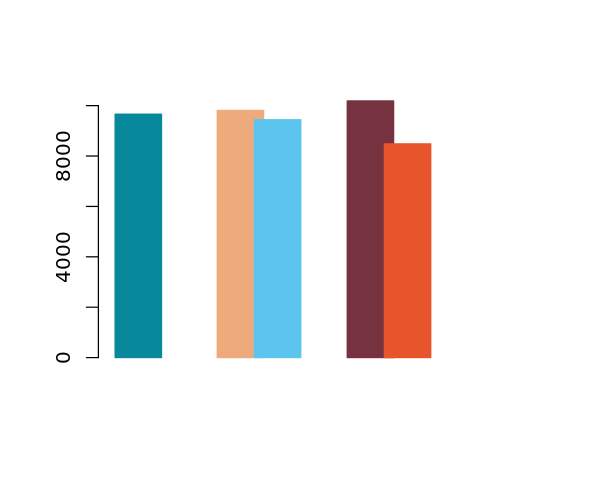

In [19]:
options(repr.plot.width = 5, repr.plot.height = 4)
ncells <- c(ncol(sce_0), ncol(sce_mesendo), ncol(sce_1), ncol(sce_defendo), ncol(sce_3))

my.xlim = c(0, max(ncells)+100)
my.ylim = c(0,9)
my.space = c(0, 1.2, -0.2, 1, -0.2)
# opar <- par(lwd = 5)
barplot(as.numeric(ncells), main = "",
        border = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        col = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        xlim = my.ylim, ylim = my.xlim, space = my.space, ylab = "", )

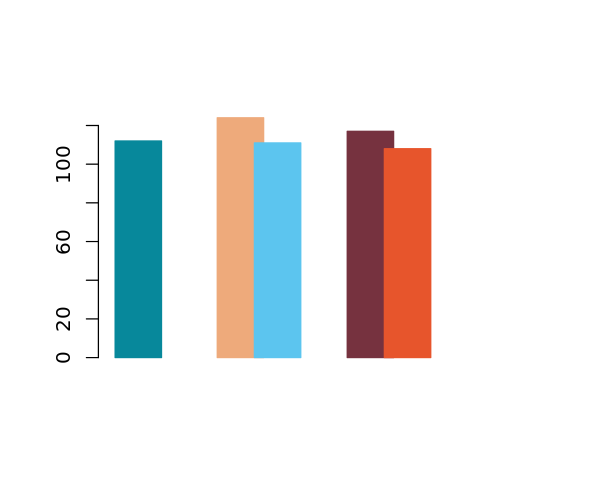

In [20]:
options(repr.plot.width = 5, repr.plot.height = 4)
ndonors <- c(length(unique(sce_0$donor_short_id)), 
             length(unique(sce_mesendo$donor_short_id)), length(unique(sce_1$donor_short_id)), 
             length(unique(sce_defendo$donor_short_id)), length(unique(sce_3$donor_short_id)))

my.xlim = c(0, max(ndonors)+10)
my.ylim = c(0,9)
my.space = c(0, 1.2, -0.2, 1, -0.2)
# opar <- par(lwd = 5)
barplot(as.numeric(ndonors), main = "",
        border = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        col = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        xlim = my.ylim, ylim = my.xlim, space = my.space, ylab = "", )

In [4]:
##############################
##### metadata for Eyal ######
##############################

In [5]:
# sce_0 = sce[, sce$day == "day0"]
unique(sce_0$donor_long_id)

[1] "HPSI0114i-zapk_3" "HPSI0214i-wibj_2" "HPSI1013i-jogf_2"
  [4] "HPSI0214i-pelm_3" "HPSI0114i-vass_1" "HPSI0214i-heth_1"
  [7] "HPSI1014i-toss_3" "HPSI0614i-paab_4" "HPSI0414i-oaqd_3"
 [10] "HPSI1013i-sita_1" "HPSI0614i-zoio_2" "HPSI0914i-kajh_3"
 [13] "HPSI0714i-fasu_2" "HPSI0414i-tout_1" "HPSI0714i-iudw_4"
 [16] "HPSI0514i-tavh_2" "HPSI0514i-pulk_1" "HPSI0215i-fawm_2"
 [19] "HPSI0714i-oebj_1" "HPSI0714i-oojs_1" "HPSI0514i-eoxi_6"
 [22] "HPSI0414i-seru_1" "HPSI0614i-guyj_2" "HPSI1014i-qayj_3"
 [25] "HPSI0414i-walu_1" "HPSI1014i-babz_3" "HPSI0114i-iisa_1"
 [28] "HPSI0414i-oikd_2" "HPSI1014i-quls_2" "HPSI0514i-sohd_3"
 [31] "HPSI0514i-letw_1" "HPSI0215i-oilg_3" "HPSI0514i-rutc_2"
 [34] "HPSI0115i-vazt_1" "HPSI0614i-oicx_6" "HPSI1113i-wahn_1"
 [37] "HPSI1014i-sehl_6" "HPSI0914i-suop_5" "HPSI0715i-aowh_2"
 [40] "HPSI0314i-cuhk_2" "HPSI0613i-hegp_3" "HPSI0713i-cicb_2"
 [43] "HPSI0614i-lepk_1" "HPSI0713i-veku_2" "HPSI0613i-ueah_1"
 [46] "HPSI0414i-naju_1" "HPSI0913i-lise_3" "HPSI0214i-eiwy_1"
 [49] "HPSI0514i-puie_5" "HPSI0115i-qoog_4" "HPSI0914i-zerv_8"
 [52] "HPSI0114i-kolf_2" "HPSI0514i-uenn_3" "HPSI0914i-iezw_2"
 [55] "HPSI0114i-wegi_1" "HPSI0314i-sojd_3" "HPSI1213i-tolg_6"
 [58] "HPSI0214i-rayr_1" "HPSI0314i-qaqx_1" "HPSI1013i-yemz_1"
 [61] "HPSI1013i-wuye_2" "HPSI0114i-joxm_1" "HPSI0214i-kucg_2"
 [64] "HPSI0114i-iisa_3" "HPSI0114i-bezi_1" "HPSI1014i-kefb_1"
 [67] "HPSI1014i-nosn_6" "HPSI1213i-pahc_4" "HPSI0414i-xojn_3"
 [70] "HPSI0314i-hoik_1" "HPSI0114i-eipl_1" "HPSI0215i-yoch_6"
 [73] "HPSI1113i-hayt_1" "HPSI1014i-eesb_1" "HPSI1013i-kuxp_1"
 [76] "HPSI0514i-yelp_3" "HPSI0614i-qunz_3" "HPSI0115i-aoxv_3"
 [79] "HPSI0115i-melw_2" "HPSI0714i-pipw_5" "HPSI1014i-juuy_2"
 [82] "HPSI0914i-jejf_2" "HPSI0914i-qehq_3" "HPSI0614i-uilk_3"
 [85] "HPSI0514i-toco_5" "HPSI1113i-hajc_1" "HPSI0514i-kuco_1"
 [88] "HPSI0115i-hecn_3" "HPSI0614i-liqa_1" "HPSI0514i-tert_1"
 [91] "HPSI0614i-ciwj_2" "HPSI0214i-poih_4" "HPSI0115i-iiyk_4"
 [94] "HPSI0614i-miaj_6" "HPSI0914i-laey_4" "HPSI0715i-meue_4"
 [97] "HPSI1014i-vils_1" "HPSI0714i-keui_1" "HPSI0514i-naah_2"
[100] "HPSI0513i-oibg_1" "HPSI0713i-nocf_2" "HPSI0813i-guss_1"
[103] "HPSI0414i-mita_2" "HPSI0214i-datg_2" "HPSI1113i-qorq_2"
[106] "HPSI0214i-feec_2" "HPSI0413i-nudd_1" "HPSI0814i-bokz_5"
[109] "HPSI0314i-wigw_2" "HPSI1013i-zagm_1" "HPSI0513i-fejf_2"
[112] "HPSI0714i-nufh_3"

In [105]:
df = data.frame(donor = sce_3$donor_short_id, cell = colnames(sce_3), batch = sce_3$experiment, 
                pseudo = range01(sce_3$PC1_top500hvgs))
head(df)

,donor,cell,batch,pseudo
21241_6#10,fafq_1,21241_6#10,expt_10,0.8092821
21241_6#100,fafq_1,21241_6#100,expt_10,0.7706029
21241_6#101,wopl_1,21241_6#101,expt_10,0.7863093
21241_6#103,sebz_1,21241_6#103,expt_10,0.7943176
21241_6#104,hayt_1,21241_6#104,expt_10,0.8619098
21241_6#105,fafq_1,21241_6#105,expt_10,0.6952971


In [101]:
write.csv(df, "/hps/nobackup/marioni/acuomo/day0_donor_cell_batch_mapping_file.csv", quote = F)

In [ ]:
######################################################################
######## select a good and a bad differentiator cell line ############
######################################################################

In [120]:
df_sel = df[df$donor %in% c("pelm_3","pahc_4"),]

In [121]:
suppressWarnings(suppressPackageStartupMessages(library(ggbeeswarm)))

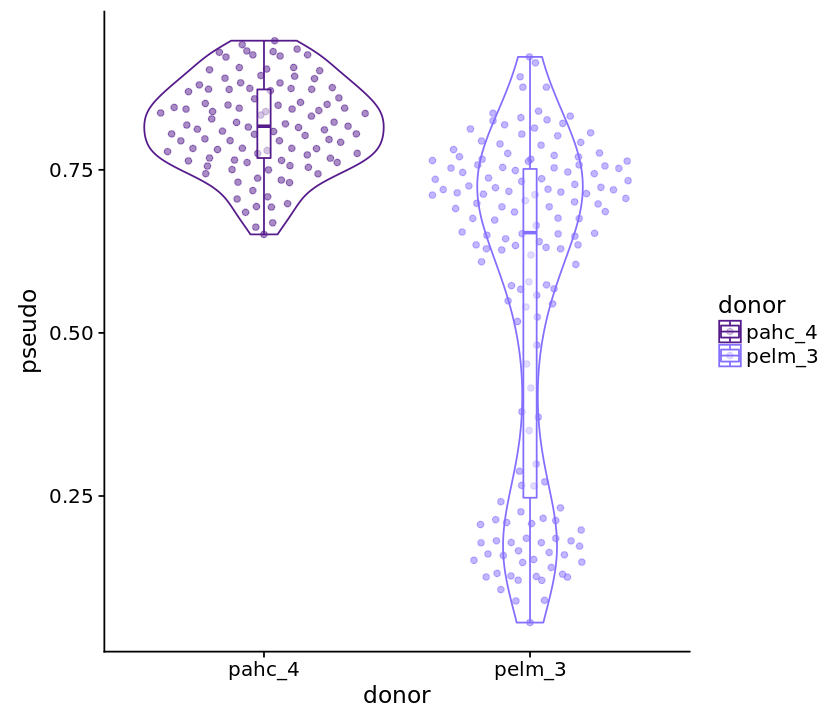

In [127]:
ggplot(df_sel, aes(x = donor, y = pseudo, colour = donor)) +
    geom_violin(alpha = 0.5) + scale_colour_manual(values = c("purple4", "slateblue1")) +
    geom_quasirandom(aes(x = donor, y = pseudo, colour = donor), alpha = 0.5) +
    geom_boxplot(width = 0.05, alpha = 0.5) 

In [ ]:
#################################################
##### quantify heterogeneity (in PCA space) #####
#################################################

In [ ]:
# one single PCA to make distances consistent

In [147]:
pcs_all = prcomp(t(logcounts(sce)))

In [ ]:
# get average cell-to-cell distance for each stage / day population (in PCA space)

In [251]:
pcs0 = pcs_all$x[colnames(sce_0),]
mean(dist(pcs0[,1:100], method = "euclidean"))

[1] 87.91492

In [252]:
pcs1 = pcs_all$x[colnames(sce_1),]
mean(dist(pcs1[,1:100], method = "euclidean"))
pcs3 = pcs_all$x[colnames(sce_3),]
mean(dist(pcs3[,1:100], method = "euclidean"))

[1] 85.01801

[1] 106.1059

In [253]:
pcs_m = pcs_all$x[colnames(sce_mesendo),]
mean(dist(pcs_m[,1:100], method = "euclidean"))
pcs_d = pcs_all$x[colnames(sce_defendo),]
mean(dist(pcs_d[,1:100], method = "euclidean"))

[1] 85.3938

[1] 102.3961

In [ ]:
############ quantify the same value for smaller populations

In [190]:
df = data.frame(donor = sce$donor_short_id, cell = colnames(sce), batch = sce$experiment, day = sce$day,
               pseudo = sce$pc1top500hvgs, stage = sce$stage_pc1top500hvgs)
rownames(df) = df$cell
head(df)

,donor,cell,batch,day,pseudo,stage
21843_1#10,joxm_1,21843_1#10,expt_09,day1,-11.7695261,mesendo
21843_1#100,fafq_1,21843_1#100,expt_09,day1,5.1315308,not assigned
21843_1#101,fafq_1,21843_1#101,expt_09,day1,-0.6430211,mesendo
21843_1#102,wuye_2,21843_1#102,expt_09,day1,-14.5080208,mesendo
21843_1#103,joxm_1,21843_1#103,expt_09,day1,-5.8029849,mesendo
21843_1#105,iisa_3,21843_1#105,expt_09,day1,-2.3442226,mesendo


In [192]:
df0 = pcs_all$x
df1 = cbind(df, df0)
head(df1)

In [152]:
# make a function
get_avg_distances <- function(df, ncomponents){
    columns_sel = paste0("PC",1:ncomponents)
    df_sel = df[,columns_sel]
    mean(dist(df_sel, method = "euclidean"))
}

In [153]:
df2 = df1 %>% group_by(day, donor, batch) 
df2$day.donor.batch = paste0(df2$day,"-",df2$donor,"-",df2$batch)
head(df2)

donor,cell,batch,day,pseudo,PC1,PC2,PC3,PC4,PC5,⋯,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,day.donor.batch
joxm_1,21843_1#10,expt_09,day1,-11.7695261,-23.227679,-6.0009258,-32.68624,-0.7904285,-12.584615,⋯,2.626139,-9.385808,-0.7260176,2.271963,2.644320,-1.7558042,4.0920525,1.84533393,-1.9069683,day1-joxm_1-expt_09
fafq_1,21843_1#100,expt_09,day1,5.1315308,13.571592,7.8418443,-47.41864,-11.0722754,-9.363870,⋯,5.557559,-4.253313,0.8928794,4.150566,1.770210,-9.3830993,0.7692899,0.06286961,1.8893813,day1-fafq_1-expt_09
fafq_1,21843_1#101,expt_09,day1,-0.6430211,-7.832704,-11.1778749,-43.90159,-6.3643469,-9.685120,⋯,1.721076,-1.294292,2.3375654,2.710075,5.684939,-1.8709090,1.5094928,-0.27347977,1.4562444,day1-fafq_1-expt_09
wuye_2,21843_1#102,expt_09,day1,-14.5080208,-29.235707,-0.7913266,-28.76609,-0.6348420,-9.783291,⋯,4.437142,-6.648654,2.5110526,4.991488,7.988059,-0.5431643,-0.2406390,0.47825023,-0.2187761,day1-wuye_2-expt_09
joxm_1,21843_1#103,expt_09,day1,-5.8029849,-18.718534,-11.3441004,-33.91354,-7.4310880,-6.942560,⋯,5.135727,-5.201503,-5.0336150,2.105118,3.338472,-4.0954286,4.1512603,1.15015836,-2.9003867,day1-joxm_1-expt_09
iisa_3,21843_1#105,expt_09,day1,-2.3442226,-17.234983,-15.0690889,-33.02414,-16.6611149,-10.665460,⋯,6.058571,-2.256506,0.6583701,1.061141,1.055648,-1.7461018,-1.5701228,-2.68496416,-1.6472035,day1-iisa_3-expt_09


In [194]:
df3 = df1 %>% group_by(stage, donor, batch) 
df3$stage.donor.batch = paste0(df3$stage,"-",df3$donor,"-",df3$batch)
head(df3)

donor,cell,batch,day,pseudo,stage,PC1,PC2,PC3,PC4,⋯,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,stage.donor.batch
joxm_1,21843_1#10,expt_09,day1,-11.7695261,mesendo,-23.227679,-6.0009258,-32.68624,-0.7904285,⋯,2.626139,-9.385808,-0.7260176,2.271963,2.644320,-1.7558042,4.0920525,1.84533393,-1.9069683,mesendo-joxm_1-expt_09
fafq_1,21843_1#100,expt_09,day1,5.1315308,not assigned,13.571592,7.8418443,-47.41864,-11.0722754,⋯,5.557559,-4.253313,0.8928794,4.150566,1.770210,-9.3830993,0.7692899,0.06286961,1.8893813,not assigned-fafq_1-expt_09
fafq_1,21843_1#101,expt_09,day1,-0.6430211,mesendo,-7.832704,-11.1778749,-43.90159,-6.3643469,⋯,1.721076,-1.294292,2.3375654,2.710075,5.684939,-1.8709090,1.5094928,-0.27347977,1.4562444,mesendo-fafq_1-expt_09
wuye_2,21843_1#102,expt_09,day1,-14.5080208,mesendo,-29.235707,-0.7913266,-28.76609,-0.6348420,⋯,4.437142,-6.648654,2.5110526,4.991488,7.988059,-0.5431643,-0.2406390,0.47825023,-0.2187761,mesendo-wuye_2-expt_09
joxm_1,21843_1#103,expt_09,day1,-5.8029849,mesendo,-18.718534,-11.3441004,-33.91354,-7.4310880,⋯,5.135727,-5.201503,-5.0336150,2.105118,3.338472,-4.0954286,4.1512603,1.15015836,-2.9003867,mesendo-joxm_1-expt_09
iisa_3,21843_1#105,expt_09,day1,-2.3442226,mesendo,-17.234983,-15.0690889,-33.02414,-16.6611149,⋯,6.058571,-2.256506,0.6583701,1.061141,1.055648,-1.7461018,-1.5701228,-2.68496416,-1.6472035,mesendo-iisa_3-expt_09


In [197]:
sample = "not assigned-fafq_1-expt_09"
stage = gsub("-.*","",sample)
stage

[1] "not assigned"

In [160]:
length(unique(df2$day.donor.batch))

[1] 517

In [161]:
sce

class: SingleCellExperiment 
dim: 11231 36044 
metadata(4): log.exprs.offset log.exprs.offset log.exprs.offset
  log.exprs.offset
assays(3): tpm counts logcounts
rownames(11231): ENSG00000000003_TSPAN6 ENSG00000000419_DPM1 ...
  ENSG00000272325_NUDT3 ENSG00000272398_CD24
rowData names(17): exprs_collapsed_to ensembl_transcript_id ...
  is_intop2000hvg is_hvg
colnames(36044): 21843_1#10 21843_1#100 ... 24539_8#97 24539_8#98
colData names(126): adj_x adj_y ... pc1top500hvgs stage_pc1top500hvgs
reducedDimNames(1): PCA
spikeNames(1): ERCC

In [180]:
het = c()
for (i in 1:length(unique(df2$day.donor.batch))){
# for (i in 1:20){
#     print(i)
    sample = unique(df2$day.donor.batch)[i]
#     print(sample)
    day = gsub("-.*","",sample)
    donor = gsub(".*-","",gsub("-e.*","",sample))
    batch = gsub(".*-","",sample)
#     print(day)
#     print(donor)
#     print(batch)
    sce_curr = sce[,(sce$day == day | sce$stage_pc1top500hvgs == day) & sce$donor_short_id == donor & sce$experiment == batch]
#     print(sce_curr)
    pcs = pcs_all$x[colnames(sce_curr),]
#     print(df2[df2$day.donor.batch == sample,])
    het[i] = get_avg_distances(pcs, 20)
}

In [231]:
het1 = c()
for (i in 1:length(unique(df3$stage.donor.batch))){
# for (i in 1:50){
#     print(i)
    sample = unique(df3$stage.donor.batch)[i]
#     print(sample)
    stage = gsub("-.*","",sample)
    donor = gsub(".*-","",gsub("-e.*","",sample))
    batch = gsub(".*-","",sample)
#     print(day)
#     print(donor)
#     print(batch)
    sce_curr = sce[, sce$stage_pc1top500hvgs == stage & sce$donor_short_id == donor & sce$experiment == batch]
    if (ncol(sce_curr) == 1){
        het1[i] = 0
        next
    }
    pcs = pcs_all$x[colnames(sce_curr),]
#     print(df2[df2$day.donor.batch == sample,])
    het1[i] = get_avg_distances(pcs, 20)
}

In [230]:
length(unique(het1))

[1] 50

In [183]:
for (i in 1:length(unique(df2$day.donor.batch))){
    sample = unique(df2$day.donor.batch)[i]
    df2[df2$day.donor.batch == sample,"heterogeneity"]= het[i] 
}

In [232]:
for (i in 1:length(unique(df3$stage.donor.batch))){
    sample = unique(df3$stage.donor.batch)[i]
    df3[df3$stage.donor.batch == sample,"heterogeneity"]= het1[i] 
}

Warning message:
“Removed 1151 rows containing non-finite values (stat_ydensity).”Warning message:
“Removed 1151 rows containing non-finite values (stat_boxplot).”

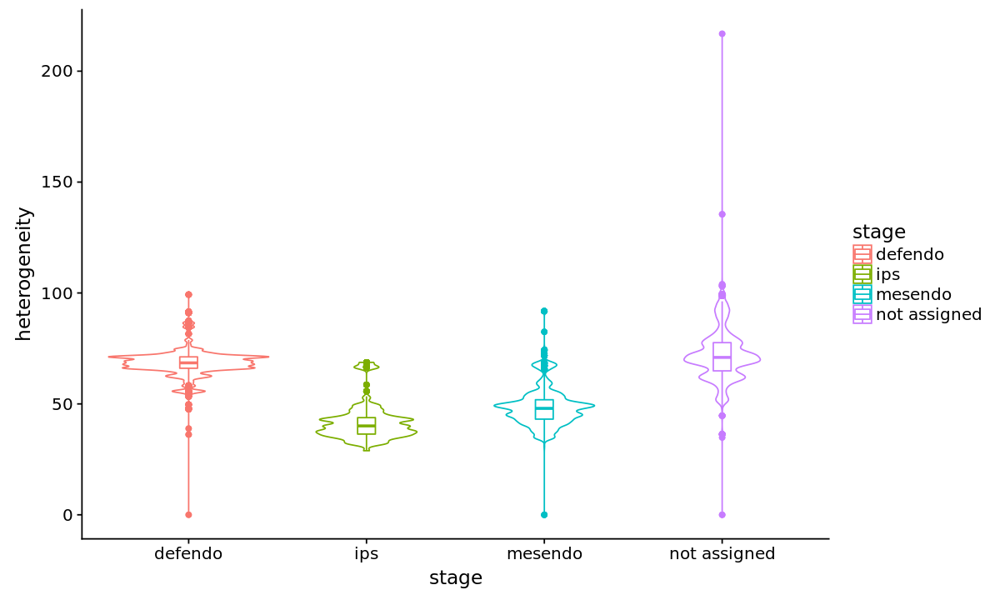

In [233]:
ggplot(df3, aes(x = stage, y = heterogeneity, colour = stage)) + geom_violin() + geom_boxplot(width = 0.1)

In [157]:
write.csv(df2, "/hps/nobackup/marioni/acuomo/heterogeneity_by_donor_day_batch.csv", quote = F)

Warning message:
“Removed 1151 rows containing non-finite values (stat_ydensity).”Warning message:
“Removed 1151 rows containing non-finite values (stat_boxplot).”

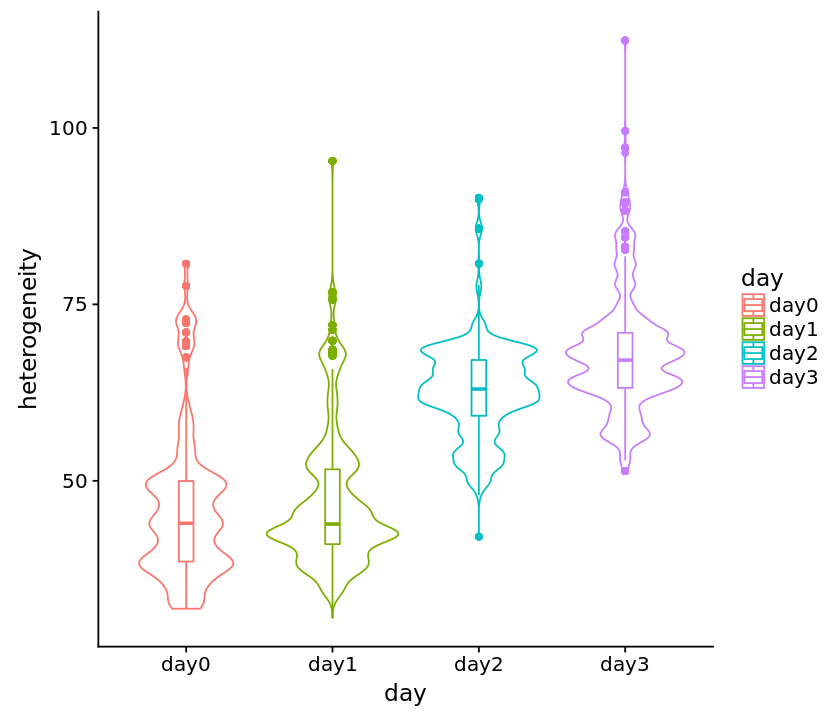

In [189]:
ggplot(df2, aes(x = day, y = heterogeneity, colour = day)) + geom_violin() + geom_boxplot(width = 0.1)

In [203]:
head(df2)
head(df3)

donor,cell,batch,day,pseudo,PC1,PC2,PC3,PC4,PC5,⋯,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,day.donor.batch,heterogeneity
joxm_1,21843_1#10,expt_09,day1,-11.7695261,-23.227679,-6.0009258,-32.68624,-0.7904285,-12.584615,⋯,-9.385808,-0.7260176,2.271963,2.644320,-1.7558042,4.0920525,1.84533393,-1.9069683,day1-joxm_1-expt_09,37.52198
fafq_1,21843_1#100,expt_09,day1,5.1315308,13.571592,7.8418443,-47.41864,-11.0722754,-9.363870,⋯,-4.253313,0.8928794,4.150566,1.770210,-9.3830993,0.7692899,0.06286961,1.8893813,day1-fafq_1-expt_09,37.21882
fafq_1,21843_1#101,expt_09,day1,-0.6430211,-7.832704,-11.1778749,-43.90159,-6.3643469,-9.685120,⋯,-1.294292,2.3375654,2.710075,5.684939,-1.8709090,1.5094928,-0.27347977,1.4562444,day1-fafq_1-expt_09,37.21882
wuye_2,21843_1#102,expt_09,day1,-14.5080208,-29.235707,-0.7913266,-28.76609,-0.6348420,-9.783291,⋯,-6.648654,2.5110526,4.991488,7.988059,-0.5431643,-0.2406390,0.47825023,-0.2187761,day1-wuye_2-expt_09,35.49993
joxm_1,21843_1#103,expt_09,day1,-5.8029849,-18.718534,-11.3441004,-33.91354,-7.4310880,-6.942560,⋯,-5.201503,-5.0336150,2.105118,3.338472,-4.0954286,4.1512603,1.15015836,-2.9003867,day1-joxm_1-expt_09,37.52198
iisa_3,21843_1#105,expt_09,day1,-2.3442226,-17.234983,-15.0690889,-33.02414,-16.6611149,-10.665460,⋯,-2.256506,0.6583701,1.061141,1.055648,-1.7461018,-1.5701228,-2.68496416,-1.6472035,day1-iisa_3-expt_09,42.01761


donor,cell,batch,day,pseudo,stage,PC1,PC2,PC3,PC4,⋯,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,stage.donor.batch,heterogeneity
joxm_1,21843_1#10,expt_09,day1,-11.7695261,mesendo,-23.227679,-6.0009258,-32.68624,-0.7904285,⋯,-9.385808,-0.7260176,2.271963,2.644320,-1.7558042,4.0920525,1.84533393,-1.9069683,mesendo-joxm_1-expt_09,37.52198
fafq_1,21843_1#100,expt_09,day1,5.1315308,not assigned,13.571592,7.8418443,-47.41864,-11.0722754,⋯,-4.253313,0.8928794,4.150566,1.770210,-9.3830993,0.7692899,0.06286961,1.8893813,not assigned-fafq_1-expt_09,36.31175
fafq_1,21843_1#101,expt_09,day1,-0.6430211,mesendo,-7.832704,-11.1778749,-43.90159,-6.3643469,⋯,-1.294292,2.3375654,2.710075,5.684939,-1.8709090,1.5094928,-0.27347977,1.4562444,mesendo-fafq_1-expt_09,36.50483
wuye_2,21843_1#102,expt_09,day1,-14.5080208,mesendo,-29.235707,-0.7913266,-28.76609,-0.6348420,⋯,-6.648654,2.5110526,4.991488,7.988059,-0.5431643,-0.2406390,0.47825023,-0.2187761,mesendo-wuye_2-expt_09,35.49993
joxm_1,21843_1#103,expt_09,day1,-5.8029849,mesendo,-18.718534,-11.3441004,-33.91354,-7.4310880,⋯,-5.201503,-5.0336150,2.105118,3.338472,-4.0954286,4.1512603,1.15015836,-2.9003867,mesendo-joxm_1-expt_09,37.52198
iisa_3,21843_1#105,expt_09,day1,-2.3442226,mesendo,-17.234983,-15.0690889,-33.02414,-16.6611149,⋯,-2.256506,0.6583701,1.061141,1.055648,-1.7461018,-1.5701228,-2.68496416,-1.6472035,mesendo-iisa_3-expt_09,42.01761


Warning message:
“Removed 2302 rows containing non-finite values (stat_boxplot).”

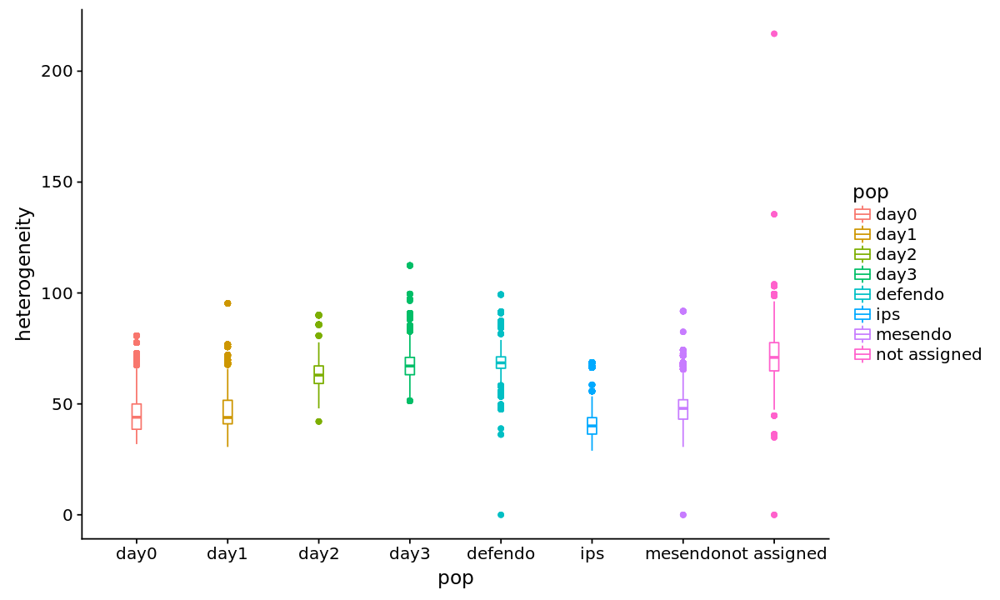

In [235]:
df2_bis = df2[,c("day","heterogeneity")]
colnames(df2_bis)[1] = "pop"
df3_bis = df3[,c("stage","heterogeneity")]
colnames(df3_bis)[1] = "pop"
df4 = rbind(df2_bis,df3_bis)
options(repr.plot.width = 10, repr.plot.height = 6)
p = ggplot(df4, aes(x = pop, y = heterogeneity, colour = pop)) 
# p + geom_violin() 
p + geom_boxplot(width = 0.1)

In [238]:
col_ips

[1] "#07889b"

Warning message:
“Removed 1662 rows containing non-finite values (stat_boxplot).”

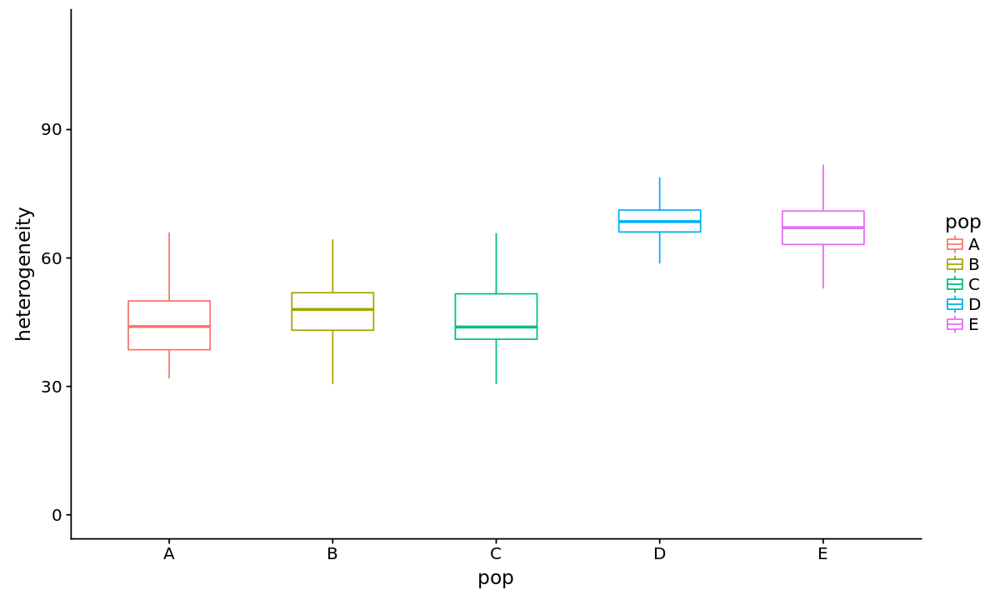

In [241]:
df5 = df4[df4$pop %in% c("day0","day1","mesendo","day3","defendo"),]
df5$pop[df5$pop == "day0"] = "A"
df5$pop[df5$pop == "mesendo"] = "B"
df5$pop[df5$pop == "day1"] = "C"
df5$pop[df5$pop == "defendo"] = "D"
df5$pop[df5$pop == "day3"] = "E"
p = ggplot(df5, aes(x = pop, y = heterogeneity, colour = pop)) 
# p = p + geom_violin()
p = p + geom_boxplot(width = 0.5, outlier.alpha = 0)
p
# p + scale_color_manual(c(col_ips, col_mesendo, col_day1, col_defendo, col_day3))

In [4]:
### define pseudotime

In [12]:
ncol(sce)
ncol(sce[,sce$stage_pc1top500hvgs == "not assigned"])

[1] 36044

[1] 7073

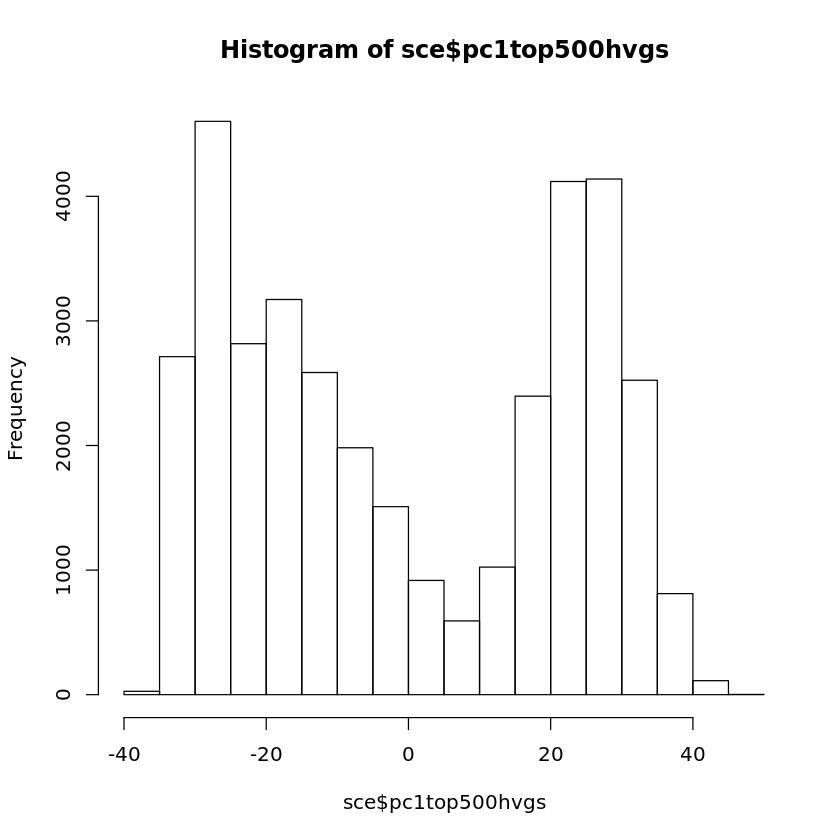

In [14]:
hist(sce$pc1top500hvgs)

In [15]:
## investigate transition population
sce_trans = sce[,sce$stage_pc1top500hvgs == "not assigned" & sce$pc1top500hvgs > 4 & sce$pc1top500hvgs < 22]

In [16]:
sce_trans

class: SingleCellExperiment 
dim: 11231 5651 
metadata(4): log.exprs.offset log.exprs.offset log.exprs.offset
  log.exprs.offset
assays(3): tpm counts logcounts
rownames(11231): ENSG00000000003_TSPAN6 ENSG00000000419_DPM1 ...
  ENSG00000272325_NUDT3 ENSG00000272398_CD24
rowData names(17): exprs_collapsed_to ensembl_transcript_id ...
  is_intop2000hvg is_hvg
colnames(5651): 21843_1#100 21843_1#143 ... 24539_2#95 24539_2#98
colData names(125): adj_x adj_y ... pc1top500hvgs stage_pc1top500hvgs
reducedDimNames(1): PCA
spikeNames(1): ERCC

In [17]:
pcs_trans = prcomp(t(logcounts(sce_trans)))

In [19]:
summary(pcs_trans)$importance[3,][20]

PC20 
0.15761

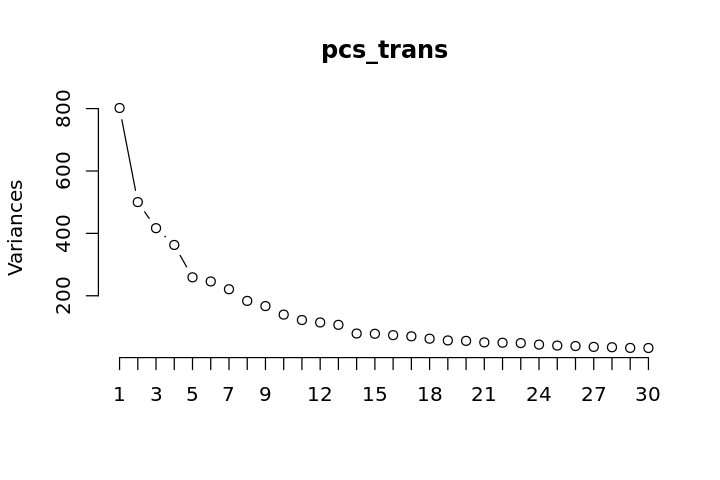

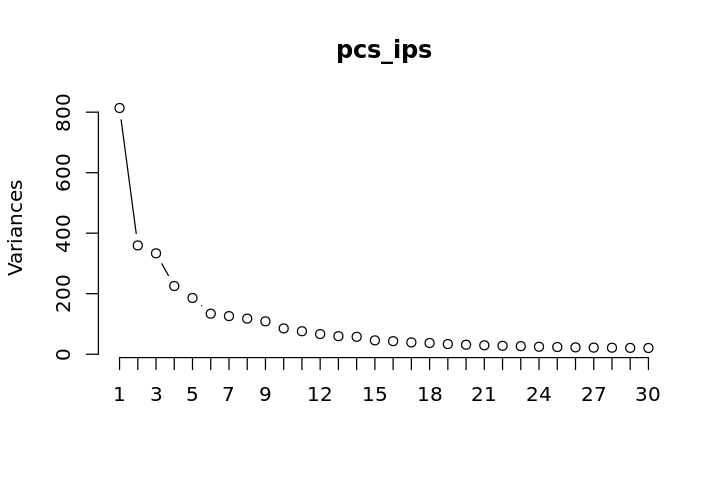

In [42]:
options(repr.plot.width = 6, repr.plot.height = 4)
screeplot(pcs_trans, 30, type = "lines")
screeplot(pcs_ips, 30, type = "lines")
# screeplot(pcs_m, 20, type = "lines")
# screeplot(pcs_d, 20, type = "lines")

In [27]:
summary(pcs0)

Importance of components:
                            PC1      PC2     PC3      PC4      PC5      PC6
Standard deviation     36.91096 18.83215 18.2086 15.06150 13.93676 13.31357
Proportion of Variance  0.06205  0.01615  0.0151  0.01033  0.00885  0.00807
Cumulative Proportion   0.06205  0.07820  0.0933  0.10363  0.11247  0.12055
                            PC7      PC8      PC9     PC10    PC11    PC12
Standard deviation     11.54726 11.42602 10.87041 10.53825 9.53093 8.92949
Proportion of Variance  0.00607  0.00595  0.00538  0.00506 0.00414 0.00363
Cumulative Proportion   0.12662  0.13256  0.13795  0.14300 0.14714 0.15077
                          PC13    PC14    PC15    PC16    PC17    PC18    PC19
Standard deviation     8.32241 7.98754 7.79301 6.97786 6.89471 6.30211 5.94834
Proportion of Variance 0.00315 0.00291 0.00277 0.00222 0.00216 0.00181 0.00161
Cumulative Proportion  0.15393 0.15683 0.15960 0.16182 0.16398 0.16579 0.16740
                          PC20    PC21    PC22    PC23

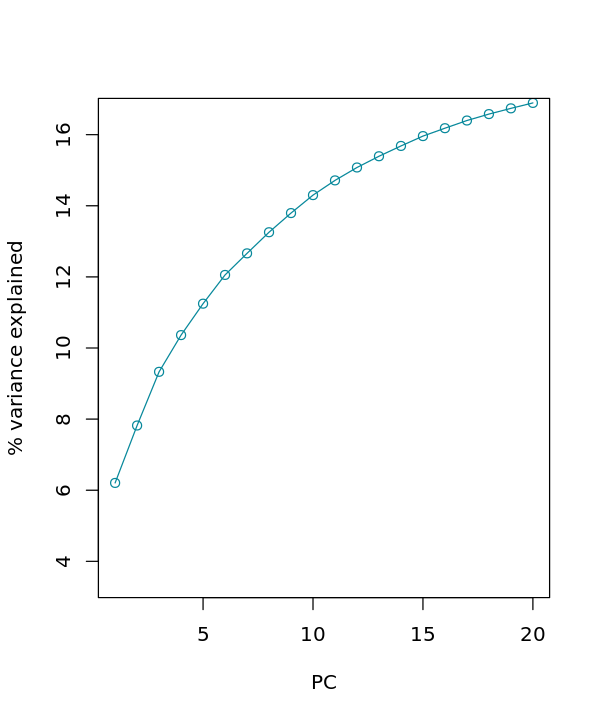

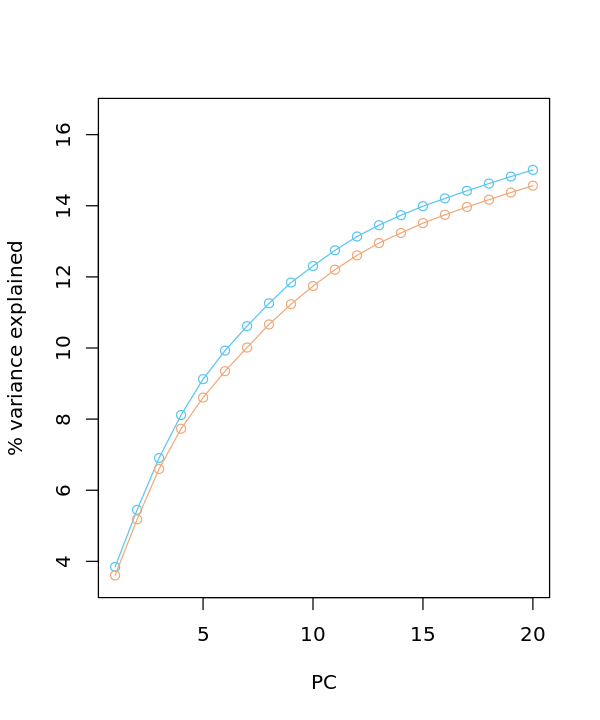

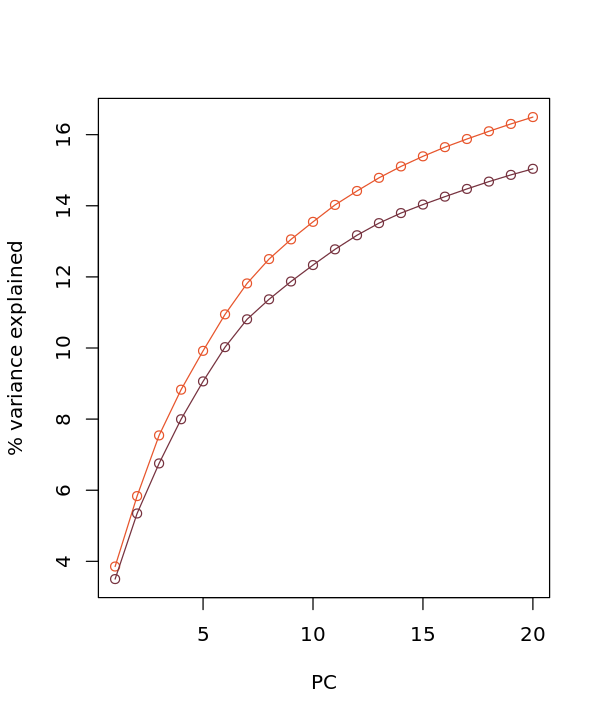

In [32]:
options(repr.plot.width = 5, repr.plot.height = 6)
col_day0 = canva_pal("Pool party")(4)[1]
col_day1 = canva_pal("Pool party")(4)[2]
col_day2 = canva_pal("Pool party")(4)[3]
col_day3 = canva_pal("Pool party")(4)[4]

col_ips = canva_pal("Modern and clean")(4)[2]
col_mesendo = canva_pal("Modern and clean")(4)[4]
col_defendo = canva_pal("Warm tones")(4)[3]
x <- c()
y <- c()
n = 20

# for (i in 1:n){
#     x[i] = i
#     y[i] = summary(pcs_trans)$importance[3,][i]
#     y[i] = summary(pcs_trans)$importance[2,][i]
# }
# points(x, y, col = "grey")
# lines(x, y, col = "grey")

for (i in 1:n){
    x[i] = i
    y[i] = summary(pcs0)$importance[3,][i]
#     y[i] = summary(pcs0)$importance[2,][i]
}
plot(x, y*100, col = col_ips, ylim = c(3.5,16.5), xlab = "PC", ylab = "% variance explained")
lines(x, y*100, col = col_ips)

for (i in 1:n){
    x[i] = i
    y[i] = summary(pcs1)$importance[3,][i]
#     y[i] = summary(pcs1)$importance[2,][i]
}
plot(x, y*100, col = col_day1, ylim = c(3.5,16.5), xlab = "PC", ylab = "% variance explained")
lines(x, y*100, col = col_day1)
for (i in 1:n){
    x[i] = i
    y[i] = summary(pcs_m)$importance[3,][i]
#     y[i] = summary(pcs_m)$importance[2,][i]
}
points(x, y*100, col = col_mesendo)
lines(x, y*100, col = col_mesendo)



for (i in 1:n){
    x[i] = i
    y[i] = summary(pcs3)$importance[3,][i]
#     y[i] = summary(pcs3)$importance[2,][i]
}
plot(x, y*100, col = col_day3, ylim = c(3.5,16.5), xlab = "PC", ylab = "% variance explained")
lines(x, y*100, col = col_day3)
for (i in 1:n){
    x[i] = i
    y[i] = summary(pcs_d)$importance[3,][i]
#     y[i] = summary(pcs_d)$importance[2,][i]
}
points(x, y*100, col = col_defendo)
lines(x, y*100, col = col_defendo)

In [10]:
ncol(sce[,sce$stage_pc1top500hvgs %in% c("ips","mesendo","defendo")])

[1] 28971

In [11]:
range01 <- function(x){(x-min(x))/(max(x)-min(x))}
sce$pseudotime  <- range01(sce$pc1top500hvgs)

In [12]:
############ day0 expression predictions of differentiation capacity

In [53]:
df_pseudo0 = data.frame(pseudo = sce_0$pseudotime, donor = sce_0$donor_short_id, batch = sce_0$experiment)
df_pseudo1 = data.frame(pseudo = sce_1$pseudotime, donor = sce_1$donor_short_id, batch = sce_1$experiment)
df_pseudo2 = data.frame(pseudo = sce_2$pseudotime, donor = sce_2$donor_short_id, batch = sce_2$experiment)
df_pseudo3 = data.frame(pseudo = sce_3$pseudotime, donor = sce_3$donor_short_id, batch = sce_3$experiment)

ERROR: Error in data.frame(pseudo = sce_0$pseudotime, donor = sce_0$donor_short_id, : arguments imply differing number of rows: 0, 9661


In [92]:
nrow(df_pseudo0)

[1] 9661

In [52]:
pseudo0 <- df_pseudo0 %>% group_by(donor,batch) %>% summarize(ncells = n(), avg_pseudo = mean(as.numeric(pseudo)))
pseudo1 <- df_pseudo1 %>% group_by(donor,batch) %>% summarize(ncells = n(), avg_pseudo = mean(as.numeric(pseudo)))
pseudo2 <- df_pseudo2 %>% group_by(donor,batch) %>% summarize(ncells = n(), avg_pseudo = mean(as.numeric(pseudo)))
pseudo3 <- df_pseudo3 %>% group_by(donor,batch) %>% summarize(ncells = n(), avg_pseudo = mean(as.numeric(pseudo)))

ERROR: Error in eval(lhs, parent, parent): object 'df_pseudo0' not found


In [44]:
N = 10
pseudo0 = pseudo0[pseudo0$ncells > N,]
pseudo1 = pseudo1[pseudo1$ncells > N,]
pseudo2 = pseudo2[pseudo2$ncells > N,]
pseudo3 = pseudo3[pseudo3$ncells > N,]

In [45]:
pseudo0_bis = inner_join(pseudo0, pseudo3, by = "donor", suffix = c(".day0",".day3"))
colnames(pseudo0_bis)[c(3,5)] <- c("avg_pseudo","diff_capacity")
pseudo1_bis = inner_join(pseudo1, pseudo3, by = "donor", suffix = c(".day1",".day3"))
colnames(pseudo1_bis)[c(3,5)] <- c("avg_pseudo","diff_capacity")
pseudo2_bis = inner_join(pseudo2, pseudo3, by = "donor", suffix = c(".day2",".day3"))
colnames(pseudo2_bis)[c(3,5)] <- c("avg_pseudo","diff_capacity")
pseudo3$diff_capacity = pseudo3$avg_pseudo

In [46]:
pseudo0_bis$day = "day0"
pseudo1_bis$day = "day1"
pseudo2_bis$day = "day2"
pseudo3$day = "day3"
cols = c("donor","day","avg_pseudo","diff_capacity")
df = rbind(pseudo0_bis[,cols], pseudo1_bis[,cols], pseudo2_bis[,cols], pseudo3[,cols])
nrow(df)
head(df)

[1] 358

donor,day,avg_pseudo,diff_capacity
aowh_2,day0,0.08048854,0.8065728
aoxv_3,day0,0.06318019,0.8101674
bokz_5,day0,0.10781365,0.6299543
cicb_2,day0,0.12387550,0.8159076
ciwj_2,day0,0.09646589,0.7368834
cuhk_2,day0,0.14265172,0.7788877


In [47]:
length(unique(df$donor))

[1] 98

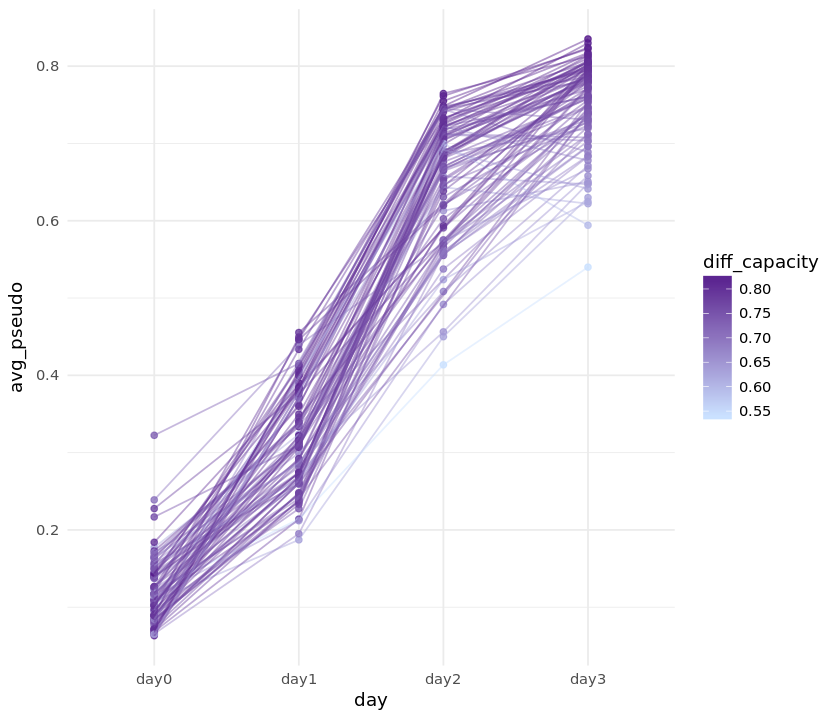

In [82]:
options(repr.plot.width = 7, repr.plot.height = 6)
# mid <- min(df$diff_capacity) + 0.55*(max(df$diff_capacity)-min(df$diff_capacity))
ggplot(df, aes(x = day, y = avg_pseudo, col = diff_capacity, group = donor)) + 
#         scale_colour_gradientn(colors = rev(brewer.pal(9,"PiYG"))) +
#         scale_colour_gradientn(colors = brewer.pal("PiYG", n = 8)) +
#         scale_colour_gradient2(midpoint = mid, low = "mediumpurple1", mid = "gray", high = "purple4", space = "Lab") +
        scale_colour_gradient(low = "lightsteelblue1", high = "purple4") +
        geom_point(alpha = 0.8) + geom_line(alpha = 0.45) + 
#         geom_point(aes(x = day, y = avg_pseudo, group = donor), colour = "darkblue",
#                data = dplyr::filter(df, diff_capacity > 0.82), alpha = 0.8) +
#         geom_line(aes(x = day, y = avg_pseudo, group = donor), colour = "darkblue",
#                data = dplyr::filter(df, diff_capacity > 0.82), alpha = 0.8) +
#         geom_point(aes(x = day, y = avg_pseudo, group = donor), colour = "firebrick",
#                data = dplyr::filter(df, diff_capacity < 0.64), alpha = 0.7) +
#         geom_line(aes(x = day, y = avg_pseudo, group = donor), colour = "firebrick",
#                data = dplyr::filter(df, diff_capacity < 0.64), alpha = 0.7) +
        theme_minimal()

In [108]:
head(pseudo3[order(df3$diff_capacity),],4)
head(pseudo3[order(df3$diff_capacity, decreasing = T),],3)

donor,batch,ncells,avg_pseudo
datg_2,expt_34,51,0.5076270
datg_2,expt_33,64,0.5656948
pelm_3,expt_40,158,0.5941620
guyj_2,expt_23,111,0.6220795


donor,batch,ncells,avg_pseudo
heth_1,expt_39,3,0.8362518
pahc_4,expt_41,109,0.8351720
naah_2,expt_29,130,0.8298561


In [54]:
options(repr.plot.width = 7, repr.plot.height = 6)
df3 = pseudo3
df3$diff_capacity = df3$avg_pseudo
ggplot(df3, aes(x = reorder(donor, -diff_capacity), y = diff_capacity, colour = diff_capacity)) + 
# #         scale_colour_gradientn(colors = rev(brewer.pal(9,"PiYG"))) +
# #         scale_colour_gradientn(colors = brewer.pal("PiYG", n = 8)) +
# #         scale_colour_gradient2(midpoint = mid, low = "mediumpurple1", mid = "gray", high = "purple4", space = "Lab") +
        scale_colour_gradient(low = "lightsteelblue1", high = "purple4") +
        geom_point(alpha = 0.8) + geom_line(alpha = 0.45) + 
        xlab("donors ordered by differentiation efficacy") + ylab("differentiation efficacy") +
# #         geom_point(aes(x = day, y = avg_pseudo, group = donor), colour = "darkblue",
# #                data = dplyr::filter(df, diff_capacity > 0.82), alpha = 0.8) +
# #         geom_line(aes(x = day, y = avg_pseudo, group = donor), colour = "darkblue",
# #                data = dplyr::filter(df, diff_capacity > 0.82), alpha = 0.8) +
# #         geom_point(aes(x = day, y = avg_pseudo, group = donor), colour = "firebrick",
# #                data = dplyr::filter(df, diff_capacity < 0.64), alpha = 0.7) +
# #         geom_line(aes(x = day, y = avg_pseudo, group = donor), colour = "firebrick",
# #                data = dplyr::filter(df, diff_capacity < 0.64), alpha = 0.7) +
        theme_bw() + theme(axis.text.x = element_blank(), axis.ticks.x = element_blank(),
                          axis.text.y = element_blank(), axis.ticks.y = element_blank())



ERROR: Error in eval(expr, envir, enclos): object 'pseudo3' not found


In [18]:
range01 <- function(x){(x-min(x))/(max(x)-min(x))}
sce$pseudotime  <- range01(sce$PC1_top500hvgs)

In [19]:
sce_0 = sce[,sce$day == "day0"]
sce_3 = sce[,sce$day == "day3"]

In [20]:
df_pseudo = data.frame(pseudo = sce_3$pseudotime, donor = sce_3$donor_short_id)
nrow(df_pseudo)
df_diff <- df_pseudo %>% group_by(donor) %>% summarize(diff_progress = mean(as.numeric(pseudo)))
nrow(df_diff)
head(df_diff)

[1] 8485

[1] 108

donor,diff_progress
aowh_2,0.8065728
aoxv_3,0.8101674
bezi_1,0.6421778
bima_1,0.6472056
bokz_5,0.6299543
cicb_2,0.8159076


In [21]:
rownames(sce)[grep("ZDHHC9", rownames(sce))]

[1] "ENSG00000188706_ZDHHC9"

In [22]:
gene = "ENSG00000188706_ZDHHC9"
# gene = "ENSG00000205542_TMSB4X"
# gene = "ENSG00000156453_PCDH1"
df_gene = data.frame(gene = logcounts(sce_0)[gene,], donor = sce_0$donor_short_id)
nrow(df_gene)
df_day0 <- df_gene %>% group_by(donor) %>% summarize(avg_gene = mean(as.numeric(gene)))
nrow(df_day0)
head(df_day0)

[1] 9661

[1] 112

donor,avg_gene
aowh_2,2.864550
aoxv_3,2.748520
babz_3,1.859796
bezi_1,4.338237
bokz_5,3.251824
cicb_2,2.934773


In [23]:
df = inner_join(df_day0, df_diff, by = "donor")
nrow(df)
head(df)

[1] 96

donor,avg_gene,diff_progress
aowh_2,2.864550,0.8065728
aoxv_3,2.748520,0.8101674
bezi_1,4.338237,0.6421778
bokz_5,3.251824,0.6299543
cicb_2,2.934773,0.8159076
ciwj_2,2.884819,0.7368834


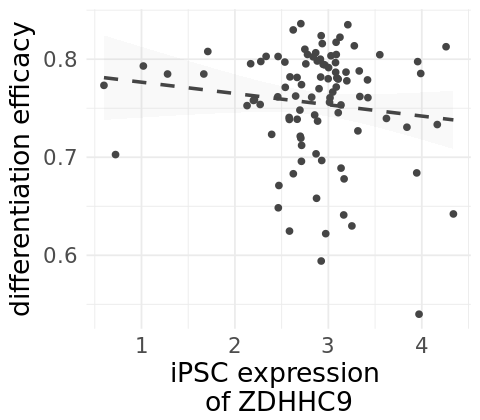

In [38]:
options(repr.plot.width = 4, repr.plot.height = 3.5)
col = "gray27"
p = ggplot(df, aes(x = avg_gene, y = diff_progress)) + geom_point(col = col)
p = p + stat_smooth(colour = col, linetype = 2, method = "lm", alpha = 0.05)
p = p + theme_minimal() 
p = p + xlab(paste0("iPSC expression \nof ", gsub(".*_","",gene))) + ylab("differentiation efficacy")
p + theme(plot.title = element_text(hjust = 0.5, colour = col),
               text = element_text(size = 16))

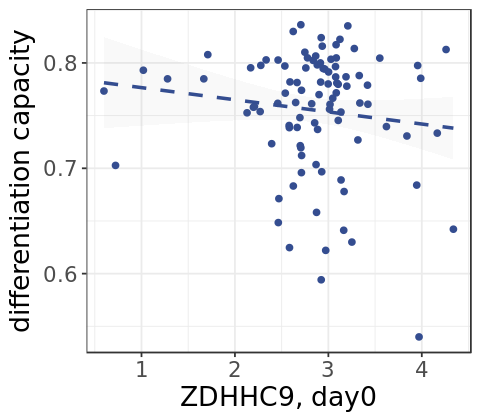

In [25]:
options(repr.plot.width = 4, repr.plot.height = 3.5)
col = "#344d90"
p = ggplot(df, aes(x = avg_gene, y = diff_progress)) + geom_point(col = col)
p = p + stat_smooth(colour = col, linetype = 2, method = "lm", alpha = 0.05)
p = p + theme_bw() + xlab(paste0(gsub(".*_","",gene), ", day0")) + ylab("differentiation capacity")
p + theme(plot.title = element_text(hjust = 0.5, colour = col),
               text = element_text(size = 16))

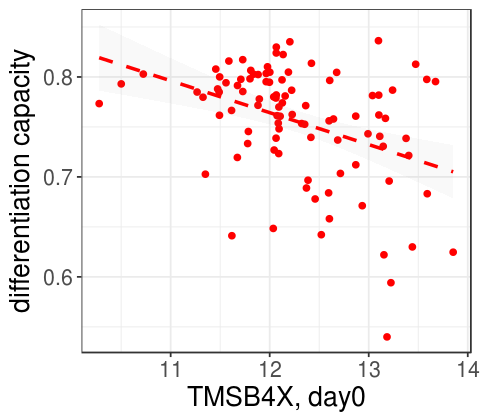

In [36]:
options(repr.plot.width = 4, repr.plot.height = 3.5)
col = "red"
p = ggplot(df, aes(x = avg_gene, y = diff_progress)) + geom_point(col = col)
p = p + stat_smooth(colour = col, linetype = 2, method = "lm", alpha = 0.05)
p = p + theme_bw() + xlab(paste0(gsub(".*_","",gene), ", day0")) + ylab("differentiation capacity")
p + theme(plot.title = element_text(hjust = 0.5, colour = col),
               text = element_text(size = 16))

In [ ]:
############ eQTL predictions of differentiation capacity

In [38]:
mini_gwas_folder = "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_endodiff/data/differentiation_gwas/"
mini_gwas_results_filename = paste0(mini_gwas_folder,"qtl_results_all.txt")
mini_gwas_results = read.csv(mini_gwas_results_filename, sep = "\t")
head(mini_gwas_results)

feature_id,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,alpha_param,beta_param,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_pvalue
pseudotime,3_16262617_C_T,5.444861e-06,-1.1309367,0.2487284,0.04183493,1,0,0,126,107,0.8139057,3460.284,3,16262617,T,NA,NA,NA
pseudotime,10_122218993_G_A,1.639674e-05,-0.6775356,0.1572360,0.10089861,1,0,0,126,107,0.8139057,3460.284,10,122218993,A,NA,NA,NA
pseudotime,19_55486167_G_C,9.793916e-05,0.5580635,0.1432533,0.38263245,1,0,0,126,107,0.8139057,3460.284,19,55486167,C,NA,NA,NA
pseudotime,10_99256756_T_C,7.087892e-04,0.4680057,0.1382115,0.94012981,1,0,0,126,107,0.8139057,3460.284,10,99256756,C,1,0.4719626,0.1760243
pseudotime,10_103550281_G_T,7.799771e-04,-0.7019466,0.2089249,0.95384774,1,0,0,126,107,0.8139057,3460.284,10,103550281,T,NA,NA,NA
pseudotime,16_75615970_C_G,1.103624e-03,-0.4607705,0.1412244,0.98571466,1,0,0,126,107,0.8139057,3460.284,16,75615970,G,NA,NA,NA


In [64]:
mini_gwas_results[-log10(mini_gwas_results$p_value) > 4,"snp_id"]

[1] "3_16262617_C_T"   "10_122218993_G_A" "19_55486167_G_C"

In [45]:
df = mini_gwas_results

In [48]:
df = df[df$snp_chromosome %in% c(1:22,"X"),]
# re-order chromosome names
df$CHR = as.factor(df$snp_chromosome)
levels(df$CHR)

[1] "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14" "15"
[16] "16" "17" "18" "19" "20" "21" "22"

In [58]:
# Prepare the dataset
don <- df %>%   
  # Compute chromosome size
  group_by(CHR) %>% 
  summarise(chr_len = max(snp_position)) %>% 
  # Calculate cumulative position of each chromosome
  dplyr::mutate(tot = cumsum(chr_len) - chr_len) %>%
  select(-chr_len) %>%  
  # Add this info to the initial dataset
  left_join(df, ., by = c("CHR" = "CHR")) %>%  
  # Add a cumulative position of each SNP
  dplyr::arrange(CHR, snp_position) %>%
  dplyr::mutate( BPcum = snp_position + tot) %>%
  # Add highlight and annotation information
#   dplyr::mutate( is_highlight1 = ifelse(feature_id %in% featuresOfInterestNotX, "yes", "no")) %>%
#   dplyr::mutate( is_highlight2 = ifelse(feature_id %in% featuresOfInterestX, "yes", "no")) %>%
#   # specific examples
#   dplyr::mutate( is_highlight3 = ifelse(feature_id == example_notX, "yes", "no")) %>%
#   dplyr::mutate( is_highlight4 = ifelse(feature_id == example_X, "yes", "no")) %>%
  # Filter SNP to make the plot lighter
  dplyr::filter(-log10(p_value) > 0)
  
# Prepare X axis
axisdf <- don %>% group_by(CHR) %>% summarize(center =( max(BPcum) + min(BPcum) ) / 2 )

# Make the plot
p <- ggplot(don, aes(x = BPcum, y = -log10(p_value), text = "")) +
    
    # Show all points
    geom_point( aes(color = as.factor(CHR)), alpha = 0.6, size = 2) +
    scale_color_manual(values = rep(c("grey75", "dimgrey"), 22 )) +
    
    # custom X axis:
    scale_x_continuous( label = axisdf$CHR, breaks = axisdf$center ) +
    scale_y_continuous(expand = c(0, 0) ) +     # remove space between plot area and x axis
    ylim(0,-log10(min(don$p_value))+0.5)+ 
    xlab("SNP location") +
    ylab("-log10(P)") +

    # Add highlighted points
#     geom_point(data = subset(don, is_highlight1 == "yes"), col = "dodgerblue", size = 1.2, alpha = 0.3) +
#     geom_point(data = subset(don, is_highlight2 == "yes"), col = "firebrick", size = 1.2, alpha = 0.3) +
#     geom_point(data = subset(don, is_highlight3 == "yes"), col = "red", size = 2.5) +
#     geom_point(data = subset(don, is_highlight4 == "yes"), col = "#344d90", size = 2.5) +
 
#     geom_point(data = subset(don, is_highlight3 == "yes"), col = "green", size = 3) +
    
    # Add significance threshold
    geom_hline(yintercept = 5, alpha = 0.3, col = "dodgerblue") +
    
    # Custom the theme:
    theme_bw() +
    theme( 
      legend.position="none",
      panel.border = element_blank(),
      panel.grid.major.x = element_blank(),
      panel.grid.minor.x = element_blank(),
      panel.grid.major.y = element_blank(),
      text = element_text(size = 16)
    ) 

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.


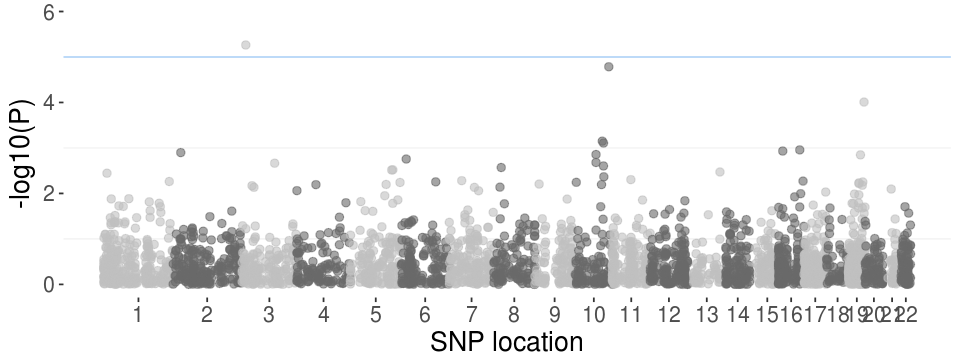

In [59]:
options(repr.plot.width = 8, repr.plot.height = 3)
p

In [ ]:
######### measure "heterogeneity" per population

In [11]:
pcs0 = prcomp(t(logcounts(sce_0)))

In [77]:
pcs0 = prcomp(t(logcounts(sce_0)))

In [36]:
pcs_ips = prcomp(t(logcounts(sce_ips)))

In [12]:
pcs_m = prcomp(t(logcounts(sce_mesendo)))

In [13]:
pcs1 = prcomp(t(logcounts(sce_1)))

In [14]:
pcs_d = prcomp(t(logcounts(sce_defendo)))

In [15]:
pcs3 = prcomp(t(logcounts(sce_3)))

In [18]:
pca.set = pcs_ips
perc_var <- round(summary(pca.set)$importance[2,]*100, 3)
perc_var[1]

PC1 
4.008

In [23]:
perc_var <- round(summary(pcs_m)$importance[2,]*100, 3)
perc_var[1]
perc_var <- round(summary(pcs1)$importance[2,]*100, 3)
perc_var[1]

PC1 
3.605

PC1 
3.842

In [13]:
perc_var <- round(summary(pcs_d)$importance[2,]*100, 3)
perc_var[1]
perc_var <- round(summary(pcs3)$importance[2,]*100, 3)
perc_var[1]

PC1 
3.501

PC1 
3.854

In [48]:
sce_0

class: SingleCellExperiment 
dim: 11231 9661 
metadata(4): log.exprs.offset log.exprs.offset log.exprs.offset
  log.exprs.offset
assays(3): tpm counts logcounts
rownames(11231): ENSG00000000003_TSPAN6 ENSG00000000419_DPM1 ...
  ENSG00000272325_NUDT3 ENSG00000272398_CD24
rowData names(17): exprs_collapsed_to ensembl_transcript_id ...
  is_intop2000hvg is_hvg
colnames(9661): 21672_1#101 21672_1#102 ... 24475_8#96 24475_8#98
colData names(123): adj_x adj_y ... princ_curve princ_curve_scaled01
reducedDimNames(1): PCA
spikeNames(1): ERCC

In [47]:
var(sce_ips$pc1top500hvgs)
var(sce_mesendo$pc1top500hvgs)
var(sce_1$pc1top500hvgs)
var(sce_defendo$pc1top500hvgs)
var(sce_3$pc1top500hvgs)

[1] 10.46622

[1] 46.39369

[1] 54.65121

[1] 19.26278

[1] 131.7984

In [27]:
var(sce_ips$pc1top500hvgs)/ncol(sce_ips)
var(sce_mesendo$pc1top500hvgs)/ncol(sce_mesendo)
var(sce_1$pc1top500hvgs)/ncol(sce_1)
var(sce_defendo$pc1top500hvgs)/ncol(sce_defendo)
var(sce_3$pc1top500hvgs)/ncol(sce_3)

[1] 0.001166153

[1] 0.004729706

[1] 0.005787483

[1] 0.001890918

[1] 0.01553311

In [29]:
summary(pcs_ips)$importance[3,][3]
summary(pcs1)$importance[3,][3]
summary(pcs_m)$importance[3,][3]
summary(pcs3)$importance[3,][3]
summary(pcs_d)$importance[3,][3]

PC3 
0.07421

PC3 
0.06906

PC3 
0.06597

PC3 
0.07542

PC3 
0.06754

In [3]:
library(ggthemes)

In [7]:
col_day0 = canva_pal("Pool party")(4)[1]
col_day1 = canva_pal("Pool party")(4)[2]
col_day2 = canva_pal("Pool party")(4)[3]
col_day3 = canva_pal("Pool party")(4)[4]
# col_ips = "cornflowerblue"
# col_mesendo = "forestgreen"
# col_defendo = "coral"
col_ips = canva_pal("Modern and clean")(4)[2]
col_mesendo = canva_pal("Modern and clean")(4)[4]
col_defendo = canva_pal("Warm tones")(4)[3]

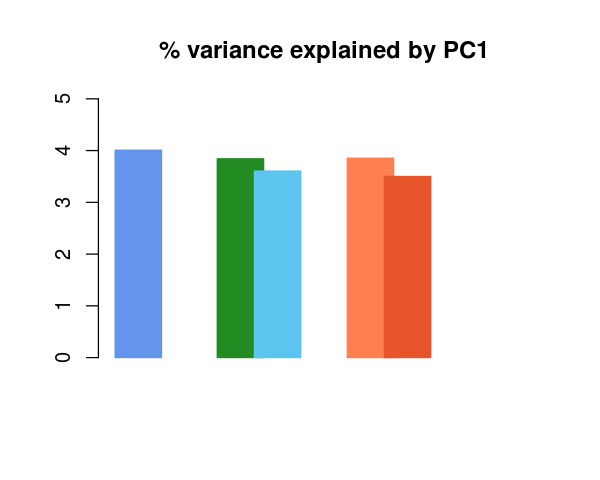

In [40]:
options(repr.plot.width = 5, repr.plot.height = 4)
# eqtls <- c(1833, 1702, 1181, 1342, 631)
eqtls <- c(summary(pcs_ips)$importance[2,][1],
           summary(pcs1)$importance[2,][1],
           summary(pcs_m)$importance[2,][1],
           summary(pcs3)$importance[2,][1],
           summary(pcs_d)$importance[2,][1])

my.xlim = c(0, max(eqtls)*100+1)
my.ylim = c(0,9)
my.space = c(0, 1.2, -0.2, 1, -0.2)
# opar <- par(lwd = 5)
barplot(as.numeric(eqtls)*100, main = "% variance explained by PC1",
        border = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        col = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        xlim = my.ylim, ylim = my.xlim, space = my.space, ylab = "")

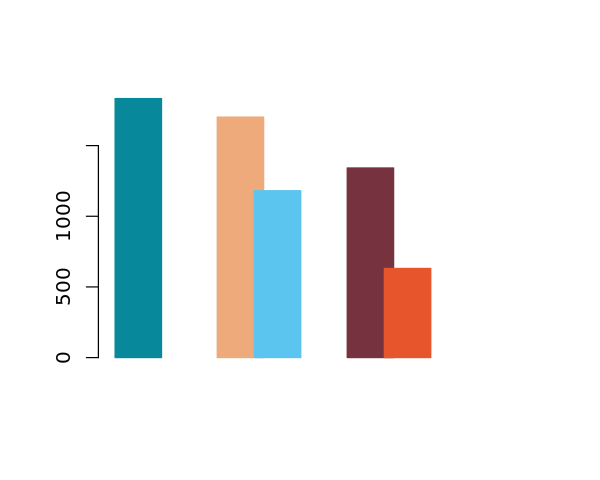

In [4]:
options(repr.plot.width = 5, repr.plot.height = 4)
eqtls <- c(1833, 1702, 1181, 1342, 631)

my.xlim = c(0, max(eqtls)+1)
my.ylim = c(0,9)
my.space = c(0, 1.2, -0.2, 1, -0.2)
# opar <- par(lwd = 5)
barplot(as.numeric(eqtls), main = "",
        border = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        col = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        xlim = my.ylim, ylim = my.xlim, space = my.space, ylab = "", )

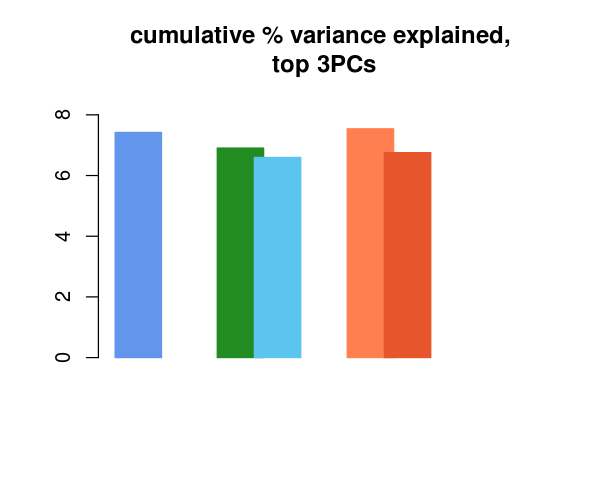

In [39]:
options(repr.plot.width = 5, repr.plot.height = 4)
# eqtls <- c(1833, 1702, 1181, 1342, 631)
eqtls <- c(summary(pcs_ips)$importance[3,][3],
           summary(pcs1)$importance[3,][3],
           summary(pcs_m)$importance[3,][3],
           summary(pcs3)$importance[3,][3],
           summary(pcs_d)$importance[3,][3])

my.xlim = c(0, max(eqtls)*100+1)
my.ylim = c(0,9)
my.space = c(0, 1.2, -0.2, 1, -0.2)
# opar <- par(lwd = 5)
barplot(as.numeric(eqtls)*100, main = "cumulative % variance explained, \ntop 3PCs",
        border = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        col = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        xlim = my.ylim, ylim = my.xlim, space = my.space, ylab = "")

In [ ]:
# correct for batches somehow
# try with one single donor (and batch)

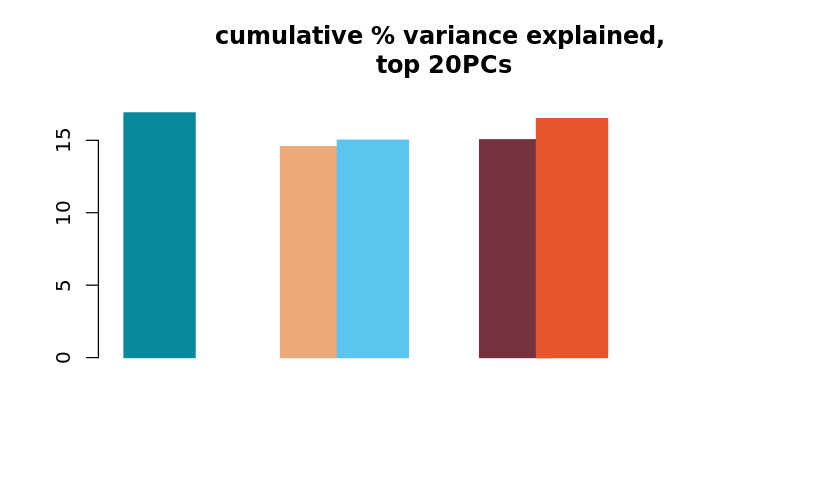

In [44]:
options(repr.plot.width = 7, repr.plot.height = 4)
# eqtls <- c(1833, 1702, 1181, 1342, 631)
eqtls <- c(summary(pcs0)$importance[3,][20],
           summary(pcs_m)$importance[3,][20],
           summary(pcs1)$importance[3,][20],
           summary(pcs_d)$importance[3,][20],
           summary(pcs3)$importance[3,][20])

my.xlim = c(0, max(eqtls)*100+1)
my.ylim = c(0,9)
my.space = c(0, 1.2, -0.2, 1, -0.2)
# opar <- par(lwd = 5)
barplot(as.numeric(eqtls)*100, main = "cumulative % variance explained, \ntop 20PCs",
        border = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        col = c(col_ips, col_mesendo, col_day1, col_defendo, col_day3),
        xlim = my.ylim, ylim = my.xlim, space = my.space, ylab = "")

In [140]:
y <- c(1833, 1702, 1181, 1342, 631)
x <- c(summary(pcs_ips)$importance[3,][20],
           summary(pcs_m)$importance[3,][20],
           summary(pcs1)$importance[3,][20],
           summary(pcs_d)$importance[3,][20],
           summary(pcs3)$importance[3,][20])
pop = c("ips","mesendo","day1","defendo","day3")
df = data.frame(var_exp_bytop20pcs = x, egenes = y, cell_population = pop)
ggplot(df, aes(x = var_exp_bytop20pcs*100, y = egenes, colour = cell_population, fill = cell_population)) + 
    geom_point(size = 4) + #xlim(c(0,16.8)) + 
    scale_color_manual(values = c(col_day1, col_day3, col_defendo, col_ips, col_mesendo)) +
    scale_fill_manual(values = c(col_day1, col_day3, col_defendo, col_ips, col_mesendo)) +
#     stat_smooth(linetype = 2, method = "lm", alpha = 0.05, col = "grey") + 
    xlab("cell population heterogeneity \ncum. var. explained by top 20 PCs (%)") + 
    ylab("eGenes detected") + theme_minimal() + geom_col()  

ERROR: Error in summary(pcs_ips): object 'pcs_ips' not found


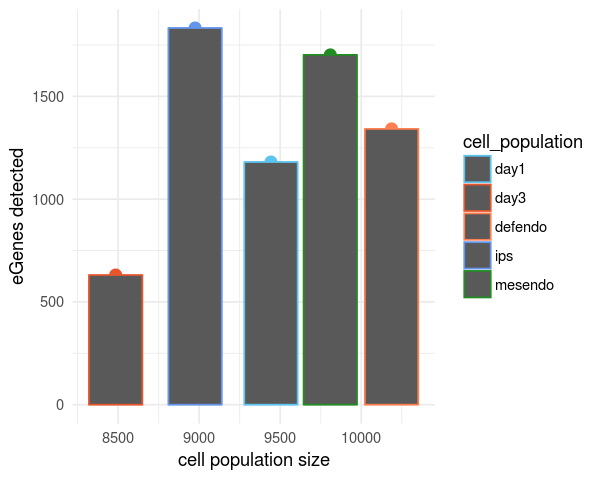

In [81]:
y <- c(1833, 1702, 1181, 1342, 631)
x <- c(ncol(sce_ips), ncol(sce_mesendo),ncol(sce_1), ncol(sce_defendo), ncol(sce_3))
pop = c("ips","mesendo","day1","defendo","day3")
df = data.frame(n_cells = x, egenes = y, cell_population = pop)
ggplot(df, aes(x = n_cells, y = egenes, colour = cell_population)) + 
    geom_point(size = 3) + scale_color_manual(values = c(col_day1, col_day3, col_defendo, col_ips, col_mesendo)) +
#     stat_smooth(linetype = 2, method = "lm", alpha = 0.05, col = "grey") + 
    xlab("cell population size") + 
    ylab("eGenes detected") + theme_minimal() + geom_col()

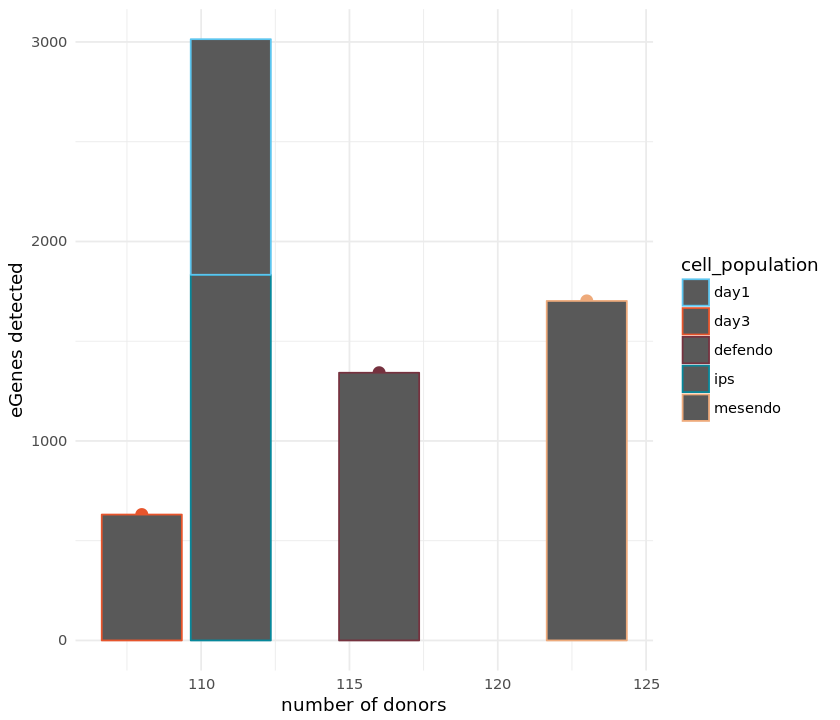

In [143]:
y <- c(1833, 1702, 1181, 1342, 631)
x <- c(length(unique(sce_ips$donor)), length(unique(sce_mesendo$donor)), length(unique(sce_1$donor)),
       length(unique(sce_defendo$donor)), length(unique(sce_3$donor)))
pop = c("ips","mesendo","day1","defendo","day3")
df = data.frame(n_donors = x, egenes = y, cell_population = pop)
ggplot(df, aes(x = n_donors, y = egenes, colour = cell_population)) + 
    geom_point(size = 3) + scale_color_manual(values = c(col_day1, col_day3, col_defendo, col_ips, col_mesendo)) +
#     stat_smooth(linetype = 2, method = "lm", alpha = 0.05, col = "grey") + 
    xlab("number of donors") + 
    ylab("eGenes detected") + theme_minimal() + geom_col()

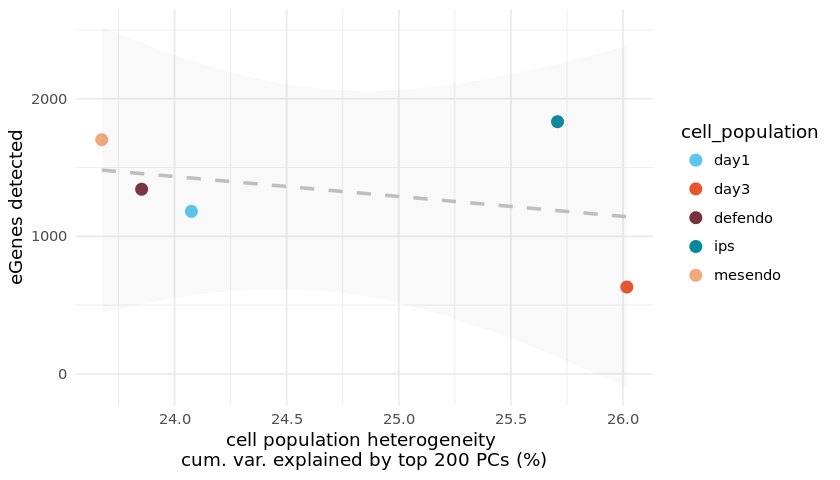

In [38]:
y <- c(1833, 1702, 1181, 1342, 631)
x <- c(summary(pcs0)$importance[3,][200],
           summary(pcs_m)$importance[3,][200],
           summary(pcs1)$importance[3,][200],
           summary(pcs_d)$importance[3,][200],
           summary(pcs3)$importance[3,][200])
pop = c("ips","mesendo","day1","defendo","day3")
df = data.frame(var_exp_bytop20pcs = x, egenes = y, cell_population = pop)
ggplot(df, aes(x = var_exp_bytop20pcs*100, y = egenes, colour = cell_population)) + 
    geom_point(size = 3) + scale_color_manual(values = c(col_day1, col_day3, col_defendo, col_ips, col_mesendo)) +
    stat_smooth(linetype = 2, method = "lm", alpha = 0.05, col = "grey") + 
    xlab("cell population heterogeneity \ncum. var. explained by top 200 PCs (%)") + 
    ylab("eGenes detected") + theme_minimal()

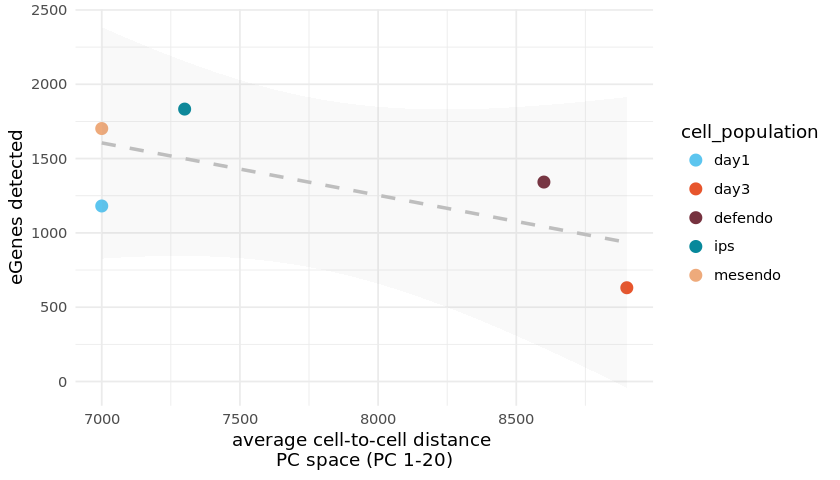

In [42]:
y <- c(1833, 1702, 1181, 1342, 631)
x <- c(73,70,70,86,89)
pop = c("ips","mesendo","day1","defendo","day3")
df = data.frame(var_exp_bytop20pcs = x, egenes = y, cell_population = pop)
ggplot(df, aes(x = var_exp_bytop20pcs*100, y = egenes, colour = cell_population)) + 
    geom_point(size = 3) + scale_color_manual(values = c(col_day1, col_day3, col_defendo, col_ips, col_mesendo)) +
    stat_smooth(linetype = 2, method = "lm", alpha = 0.05, col = "grey") + 
    xlab("average cell-to-cell distance \nPC space (PC 1-20)") + 
    ylab("eGenes detected") + theme_minimal()

In [43]:
pcs_nudd_day0 = prcomp(t(logcounts(sce_0[,sce_0])))

      
       day0 day1 day2 day3
  aowh   88  100   93   95
  aoxv   68   58   96   71
  babz   28    0   41    0
  bezi   13   11    4    3
  bima    0    0   44   31
  bokz  159  200  164  114
  cicb   42   21   75   26
  ciwj   40   27   35   39
  cuhk   41   47   39   27
  datg  185  147  136  115
  dixh    0   46   73   84
  eesb   66  106  103  195
  eipl   99  189  198   57
  eiwy   25   18   10   25
  eoxi   22   17   13    8
  fafq    0  192    0  100
  fasu   20   35    0    0
  fawm   49  128  104  172
  feec   75   62   63  106
  fejf   63   33   31   28
  fiaj    0    0   75   37
  garx    0   23    0   80
  giju    0    0  223  314
  guss  293  311  210  279
  guyj  185  105   70  111
  hajc  130   51   54   25
  hayt   41   91  107  204
  hecn  163  117  181  152
  hegp   22   13   25   16
  heth   54   19   11    3
  hiaf    0    4    0    0
  hoik   32   99   71   94
  iezw   30   85   49    0
  iisa   77   88   71    9
  iiyk   94   70   30   15
  iudw   44   97   34